# Energy gradient pagerank centrality

In [240]:
from tqdm.auto import tqdm
from collections import OrderedDict, namedtuple
from ggplot import *
from scipy import stats
from matplotlib import pyplot as plt
from sklearn.model_selection import ParameterGrid

import itertools
import pandas as pd
import networkx as nx
import numpy as np
import sys
import qgrid

sys.path.append("../..")
from networkentropy import network_energy_gradient as neg, network_utils as nu

tqdm.pandas()

## Synthetic networks

In [241]:
SEED = 10
NUM_NODES = 90

PARAM1_MAX = 5
PARAMS_N_P = ParameterGrid({'n': [NUM_NODES], 'p': [p/PARAM1_MAX for p in range(1, PARAM1_MAX)]})
PARAMS_N = ParameterGrid({'n': [NUM_NODES]})
PARAMS_N_K_ALPHA = ParameterGrid({'n': [NUM_NODES], 'k': [3], 'alpha': range(10, PARAM1_MAX*10, 10)})

Gen = namedtuple('Gen', ['generator', 'params'])
GENERATORS = {
    'random':     Gen(lambda n, p: nx.erdos_renyi_graph(n=n, p=p, directed=True, seed=SEED), PARAMS_N_P),
    'k_out':      Gen(lambda n, k, alpha: nx.DiGraph(nx.random_k_out_graph(
                      n=n, k=k, alpha=alpha, self_loops=False, seed=SEED)),                  PARAMS_N_K_ALPHA),
    'scale_free': Gen(lambda n: nx.DiGraph(nx.scale_free_graph(n=n,seed=SEED)),              PARAMS_N)
                 
}

RANDOM, K_OUT, SCALE_FREE = GENERATORS.keys()

METHODS = ['randic', 'laplacian', 'graph']
RANDIC, LAPLACIAN, GRAPH = METHODS

In [242]:
def create_graphs(generators: dict):
    graphs = []
    for name, (generator, params) in tqdm(list(generators.items())):
        for i, params_row in enumerate(params):
            row = {**params_row, 'generator': name, 'params_num': i, 'graph': generator(**params_row), 
                   'id': f'{name} {params_row}'}
            graphs.append(row)
    return pd.DataFrame(graphs)

In [243]:
graphs_df = create_graphs(GENERATORS)

In [244]:
graphs_df

,alpha,generator,graph,id,k,n,p,params_num
0,NaN,random,"(0, 1, 2, 3, 4, 5, 6, 7, 8, 9, 10, 11, 12, 13,...","random {'n': 90, 'p': 0.2}",NaN,90,0.2,0
1,NaN,random,"(0, 1, 2, 3, 4, 5, 6, 7, 8, 9, 10, 11, 12, 13,...","random {'n': 90, 'p': 0.4}",NaN,90,0.4,1
2,NaN,random,"(0, 1, 2, 3, 4, 5, 6, 7, 8, 9, 10, 11, 12, 13,...","random {'n': 90, 'p': 0.6}",NaN,90,0.6,2
3,NaN,random,"(0, 1, 2, 3, 4, 5, 6, 7, 8, 9, 10, 11, 12, 13,...","random {'n': 90, 'p': 0.8}",NaN,90,0.8,3
4,10.0,k_out,"(0, 1, 2, 3, 4, 5, 6, 7, 8, 9, 10, 11, 12, 13,...","k_out {'alpha': 10, 'k': 3, 'n': 90}",3.0,90,NaN,0
5,20.0,k_out,"(0, 1, 2, 3, 4, 5, 6, 7, 8, 9, 10, 11, 12, 13,...","k_out {'alpha': 20, 'k': 3, 'n': 90}",3.0,90,NaN,1
6,30.0,k_out,"(0, 1, 2, 3, 4, 5, 6, 7, 8, 9, 10, 11, 12, 13,...","k_out {'alpha': 30, 'k': 3, 'n': 90}",3.0,90,NaN,2
7,40.0,k_out,"(0, 1, 2, 3, 4, 5, 6, 7, 8, 9, 10, 11, 12, 13,...","k_out {'alpha': 40, 'k': 3, 'n': 90}",3.0,90,NaN,3
8,NaN,scale_free,"(0, 1, 2, 3, 4, 5, 6, 7, 8, 9, 10, 11, 12, 13,...",scale_free {'n': 90},NaN,90,NaN,0


### Calculating energy gradient centralities

Firsly pagerank is calculated for every graph and then histograms of energyu gradient centrality are ploted

In [245]:
def calculate_pagerank(graphs_df: pd.DataFrame, methods, max_iter=1000, tol=0.001) -> pd.DataFrame:
    for method in methods:
        pagerank_df = graphs_df.progress_apply(lambda s: neg.get_energy_gradient_centrality(s['graph'], method, 
                                                                                               max_iter=max_iter, 
                                                                                               tol=tol),
                                     axis=1)
        graphs_df = graphs_df.assign(**{f'{method}_pagerank': pagerank_df})
    return graphs_df

In [246]:
methods = set(METHODS).difference([LAPLACIAN])
graph_pagerank_df = calculate_pagerank(graphs_df, methods, max_iter=1000, tol=1.0e-4)

C:\Users\Tomi\Anaconda3\envs\entropy\lib\site-packages\networkx\algorithms\link_analysis\pagerank_alg.py:155: RuntimeWarning: overflow encountered in double_scalars
  err = sum([abs(x[n] - xlast[n]) for n in x])
C:\Users\Tomi\Anaconda3\envs\entropy\lib\site-packages\networkx\algorithms\link_analysis\pagerank_alg.py:152: RuntimeWarning: overflow encountered in double_scalars
  x[nbr] += alpha * xlast[n] * W[n][nbr][weight]
C:\Users\Tomi\Anaconda3\envs\entropy\lib\site-packages\networkx\algorithms\link_analysis\pagerank_alg.py:152: RuntimeWarning: invalid value encountered in double_scalars
  x[nbr] += alpha * xlast[n] * W[n][nbr][weight]


In [247]:
graph_pagerank_df

,alpha,generator,graph,id,k,n,p,params_num,randic_pagerank,graph_pagerank
0,NaN,random,"(0, 1, 2, 3, 4, 5, 6, 7, 8, 9, 10, 11, 12, 13,...","random {'n': 90, 'p': 0.2}",NaN,90,0.2,0,None,None
1,NaN,random,"(0, 1, 2, 3, 4, 5, 6, 7, 8, 9, 10, 11, 12, 13,...","random {'n': 90, 'p': 0.4}",NaN,90,0.4,1,"{0: 0.015249228961535289, 1: 0.011901492619736...",None
2,NaN,random,"(0, 1, 2, 3, 4, 5, 6, 7, 8, 9, 10, 11, 12, 13,...","random {'n': 90, 'p': 0.6}",NaN,90,0.6,2,"{0: 0.007464375063344706, 1: 0.012353305450685...","{0: 0.02930672969582124, 1: 0.0077345222726666..."
3,NaN,random,"(0, 1, 2, 3, 4, 5, 6, 7, 8, 9, 10, 11, 12, 13,...","random {'n': 90, 'p': 0.8}",NaN,90,0.8,3,None,"{0: 0.013512319461028512, 1: 0.011622996237220..."
4,10.0,k_out,"(0, 1, 2, 3, 4, 5, 6, 7, 8, 9, 10, 11, 12, 13,...","k_out {'alpha': 10, 'k': 3, 'n': 90}",3.0,90,NaN,0,"{0: 0.008100012874584452, 1: 0.008100012874584...","{0: 0.008098911428567283, 1: 0.008098911428567..."
5,20.0,k_out,"(0, 1, 2, 3, 4, 5, 6, 7, 8, 9, 10, 11, 12, 13,...","k_out {'alpha': 20, 'k': 3, 'n': 90}",3.0,90,NaN,1,"{0: 0.008657304732894371, 1: 0.008657304732894...","{0: 0.008657304732894371, 1: 0.008657304732894..."
6,30.0,k_out,"(0, 1, 2, 3, 4, 5, 6, 7, 8, 9, 10, 11, 12, 13,...","k_out {'alpha': 30, 'k': 3, 'n': 90}",3.0,90,NaN,2,"{0: 0.008543750892952253, 1: 0.008543750892952...","{0: 0.008543750892952253, 1: 0.008543750892952..."
7,40.0,k_out,"(0, 1, 2, 3, 4, 5, 6, 7, 8, 9, 10, 11, 12, 13,...","k_out {'alpha': 40, 'k': 3, 'n': 90}",3.0,90,NaN,3,"{0: 0.009744016530435523, 1: 0.009744016530435...","{0: 0.009744016530435523, 1: 0.009744016530435..."
8,NaN,scale_free,"(0, 1, 2, 3, 4, 5, 6, 7, 8, 9, 10, 11, 12, 13,...",scale_free {'n': 90},NaN,90,NaN,0,"{0: 0.06046854062157733, 1: 0.0201992513613177...","{0: 0.11902802884645407, 1: 0.0451816815435577..."


### Pagerank calculations results

For some graphs number of iterations have been exceeded before reaching tolerance. Those graphs will be further ignored.

In [248]:
def flatten_pagerank_df(pagerank_df: pd.DataFrame, methods, additional_attrs = []):
    pagerank_attrs = methods
    if len(additional_attrs) <= 0:
        additional_attrs = list(set(pagerank_df.columns).difference(pagerank_attrs))
    flatten_rows = []
    for _, row in pagerank_df.loc[:, pagerank_attrs + additional_attrs].iterrows():
        additional_attrs_values = [(attr, val) for attr, val in zip(additional_attrs, row[len(pagerank_attrs):])]
        for name, pagerank in zip(pagerank_attrs, row):
            if pagerank:
                for node, value in pagerank.items():
                    flatten_rows.append(OrderedDict(additional_attrs_values +
                                                    [('node', node), ('method', name), ('pagerank', value)]))
    return pd.DataFrame(flatten_rows)

In [261]:
pagerank_methods = [f'{m}_pagerank' for m in methods]

In [249]:
flat_graph_pagerank_df = flatten_pagerank_df(graph_pagerank_df, pagerank_methods)

In [250]:
flat_graph_pagerank_df.head()

,id,alpha,n,k,generator,params_num,graph,p,node,method,pagerank
0,"random {'n': 90, 'p': 0.4}",NaN,90,NaN,random,1,"(0, 1, 2, 3, 4, 5, 6, 7, 8, 9, 10, 11, 12, 13,...",0.4,0,randic_pagerank,0.015249
1,"random {'n': 90, 'p': 0.4}",NaN,90,NaN,random,1,"(0, 1, 2, 3, 4, 5, 6, 7, 8, 9, 10, 11, 12, 13,...",0.4,1,randic_pagerank,0.011901
2,"random {'n': 90, 'p': 0.4}",NaN,90,NaN,random,1,"(0, 1, 2, 3, 4, 5, 6, 7, 8, 9, 10, 11, 12, 13,...",0.4,2,randic_pagerank,-0.000584
3,"random {'n': 90, 'p': 0.4}",NaN,90,NaN,random,1,"(0, 1, 2, 3, 4, 5, 6, 7, 8, 9, 10, 11, 12, 13,...",0.4,3,randic_pagerank,-0.003021
4,"random {'n': 90, 'p': 0.4}",NaN,90,NaN,random,1,"(0, 1, 2, 3, 4, 5, 6, 7, 8, 9, 10, 11, 12, 13,...",0.4,4,randic_pagerank,0.010941


### Histograms

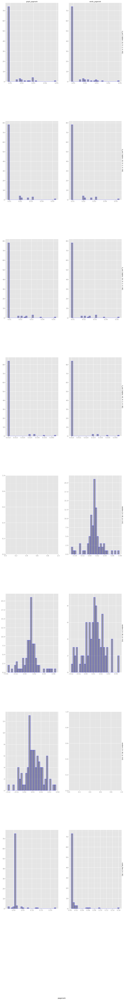

In [251]:
BINS = 30
p = ggplot(aes(x='pagerank'), data=flat_graph_pagerank_df) + \
geom_histogram(alpha=0.4, color='blue', size=3, bins=BINS) + \
facet_grid('id','method', scales = "free")

p.make()
p.fig.set_size_inches(15, 120, forward=True)
p.fig.set_dpi(100)
p.fig

plt.show()

In [252]:
def test_normality(flat_pagerank_df: pd.DataFrame, grouping_attrs):
    return flat_pagerank_df.loc[:, grouping_attrs + ['pagerank']] \
                                              .groupby(grouping_attrs) \
                                              .agg(lambda series: stats.normaltest(series))

### Normality test

Only for graph: random {'n': 90, 'p': 0.8} gradient centralities are normally distributed 

In [253]:
test_normality(flat_graph_pagerank_df, ['id', 'method'])

pagerank
id                                   method                                                       
k_out {'alpha': 10, 'k': 3, 'n': 90} graph_pagerank      (73.0308894626019, 1.385300046992262e-16)
                                     randic_pagerank     (73.9114927588582, 8.919145994393703e-17)
k_out {'alpha': 20, 'k': 3, 'n': 90} graph_pagerank     (93.80562677972742, 4.269401113743093e-21)
                                     randic_pagerank    (93.80562677972742, 4.269401113743093e-21)
k_out {'alpha': 30, 'k': 3, 'n': 90} graph_pagerank     (88.21360149309744, 6.992940312275686e-20)
                                     randic_pagerank    (88.21360149309744, 6.992940312275686e-20)
k_out {'alpha': 40, 'k': 3, 'n': 90} graph_pagerank    (108.06798191220872, 3.414568995223584e-24)
                                     randic_pagerank   (108.06798191220872, 3.414568995223584e-24)
random {'n': 90, 'p': 0.4}           randic_pagerank    (10.587053445115117, 0.005024010687358982)
random {'n': 90, 'p': 0.6}           graph_pagerank      (7.959104290030752, 0.018694009668658373)
                                     randic_pagerank     (0.22982992720734685, 0.8914419456944265)
random {'n': 90, 'p': 0.8}           graph_pagerank       (0.5790568918060922, 0.7486164975357019)
scale_free {'n': 90}                 graph_pagerank   (127.02548406690497, 2.6107579210360736e-28)
                                     randic_pagerank   (131.81166743777436, 2.384844630896535e-29)

### Visualisation of energy grdaient centrality in comparison to energy

In [265]:
def get_graph_with_energy_data(graph: nx.Graph, methods, max_iter, tol): 
    graph = neg.get_graph_with_energy_data(graph, methods=methods, clear=True)
    graph = neg.get_graph_with_energy_gradient_centrality(graph, methods=methods, max_iter=max_iter, tol=tol)
    return graph

In [266]:
synthetic_graphs_with_data_series = graph_pagerank_df.progress_apply(
    lambda s: get_graph_with_energy_data(s['graph'], methods, max_iter=2000, tol=1.0e-4), axis=1)
graph_pagerank_df = graph_pagerank_df.assign(graph=synthetic_graphs_with_data_series)

C:\Users\Tomi\Anaconda3\envs\entropy\lib\site-packages\networkx\algorithms\link_analysis\pagerank_alg.py:155: RuntimeWarning: overflow encountered in double_scalars
  err = sum([abs(x[n] - xlast[n]) for n in x])
C:\Users\Tomi\Anaconda3\envs\entropy\lib\site-packages\networkx\algorithms\link_analysis\pagerank_alg.py:152: RuntimeWarning: overflow encountered in double_scalars
  x[nbr] += alpha * xlast[n] * W[n][nbr][weight]
C:\Users\Tomi\Anaconda3\envs\entropy\lib\site-packages\networkx\algorithms\link_analysis\pagerank_alg.py:152: RuntimeWarning: invalid value encountered in double_scalars
  x[nbr] += alpha * xlast[n] * W[n][nbr][weight]


In [116]:
def draw_network(graph, node_attribute, edge_attribute, title, nodes_bar_title, edges_bar_title):
    nodes_colors = list(nx.get_node_attributes(graph, node_attribute).values())
    edges_colors = list(nx.get_edge_attributes(graph, edge_attribute).values())
    if nodes_colors and edges_colors:
        plt.figure(figsize=(18, 12))
        pos = nx.layout.kamada_kawai_layout(graph)
        nodes = nx.draw_networkx_nodes(graph, pos, node_color=nodes_colors, cmap=plt.cm.coolwarm, 
                                       with_labels=False)
        edges = nx.draw_networkx_edges(graph, pos, edge_color=edges_colors, edge_cmap=plt.cm.Reds, width=2, 
                                       with_labels=False)
    #     edges_cbar = plt.colorbar(edges)
    #     edges_cbar.ax.set_title(edges_bar_title)
        nodes_cbar = plt.colorbar(nodes)
        nodes_cbar.ax.set_title(nodes_bar_title)
        plt.title(title)
        plt.axis('off')
        plt.show()
    else:
        print(f'Graph {title} does not contain {node_attribute} or {edge_attribute}')

In [117]:
def draw_synthetic_networks(graph_pagerank_df: pd.DataFrame, method: str):
    for _, (graph, graph_id) in tqdm(list(graph_pagerank_df.loc[:,['graph', 'id']].iterrows())):
        title = f'Graph energy centrality, {graph_id}'
        nodes_bar_title = 'energy gradient centrality'
        edges_bar_title = 'gradient'
        draw_network(graph, neg._get_centrality_name(method), neg._get_gradient_method_name(method), title, 
                     nodes_bar_title, edges_bar_title)
        title = f'Graph energy, generator: {graph_id}'
        nodes_bar_title = 'energy'
        draw_network(graph, neg._get_energy_method_name(method), neg._get_gradient_method_name(method), title, 
                     nodes_bar_title, edges_bar_title)

Graph Graph energy centrality, random {'n': 90, 'p': 0.2} does not contain graph_gradient_centrality or graph_gradient


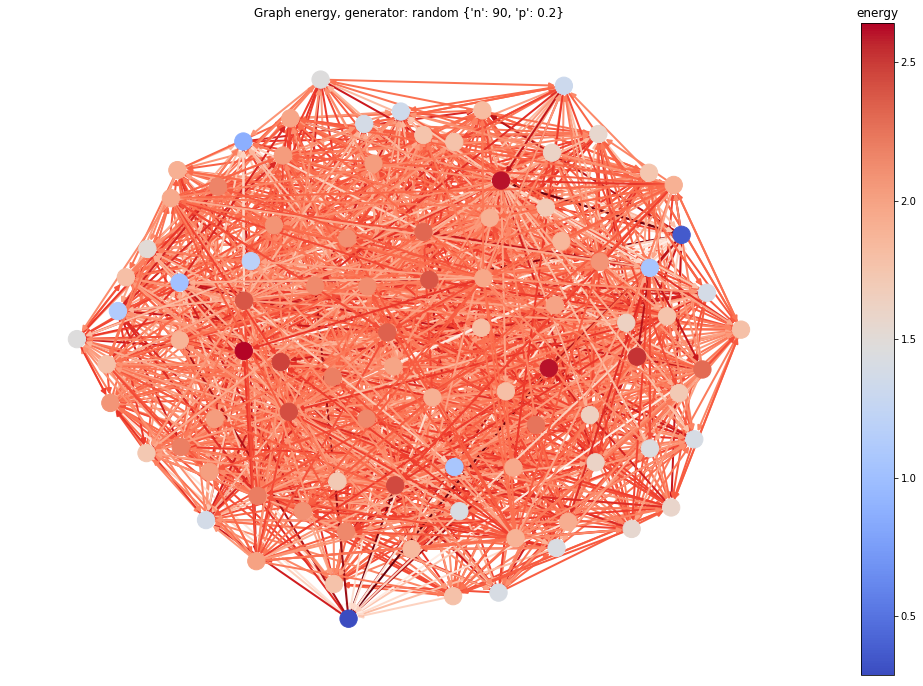

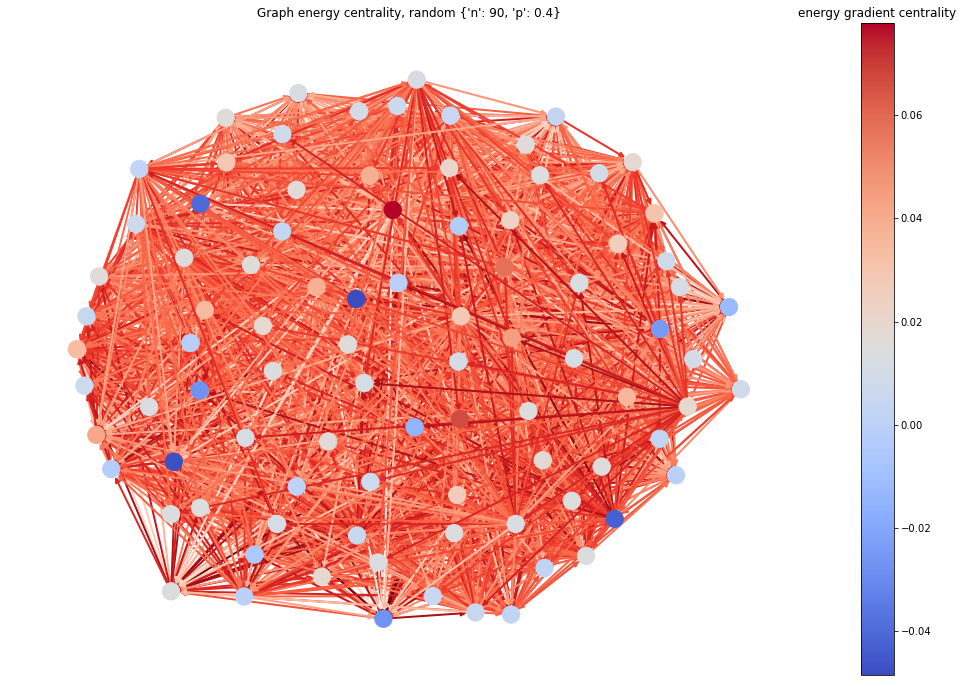

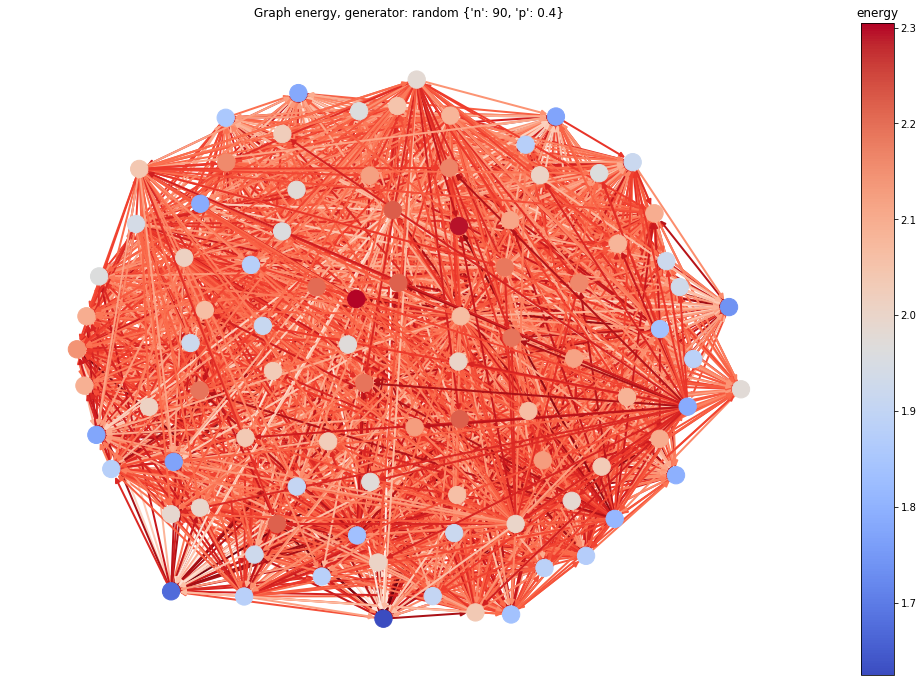

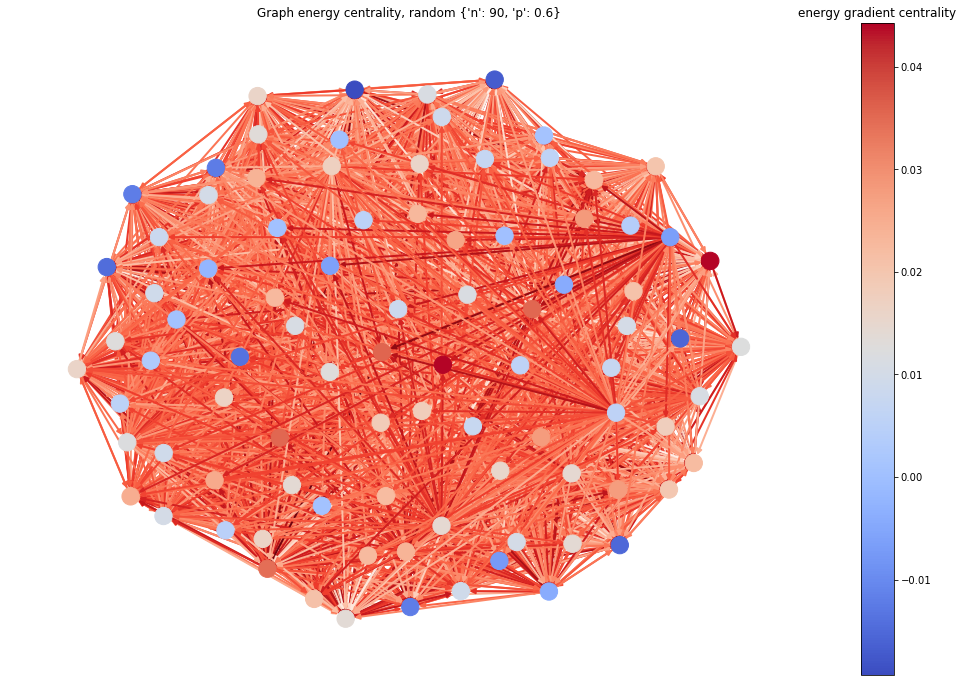

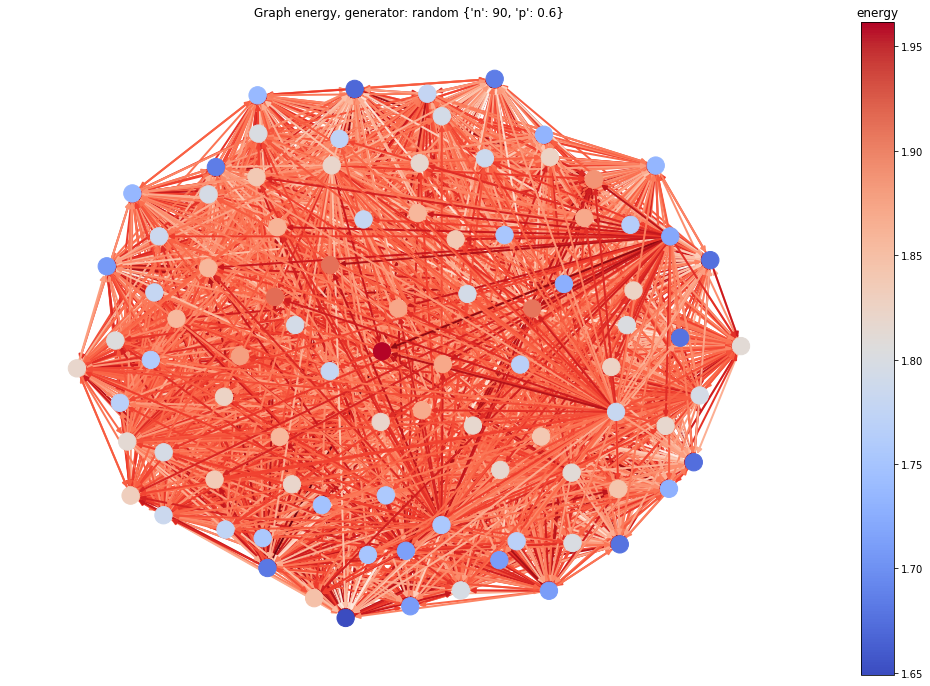

Graph Graph energy centrality, random {'n': 90, 'p': 0.8} does not contain graph_gradient_centrality or graph_gradient


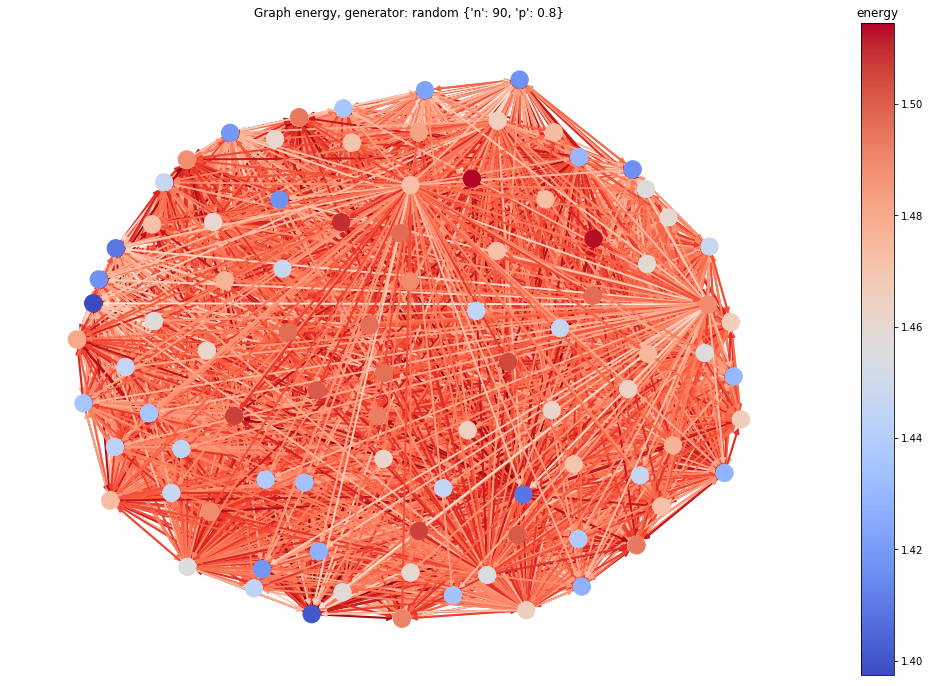

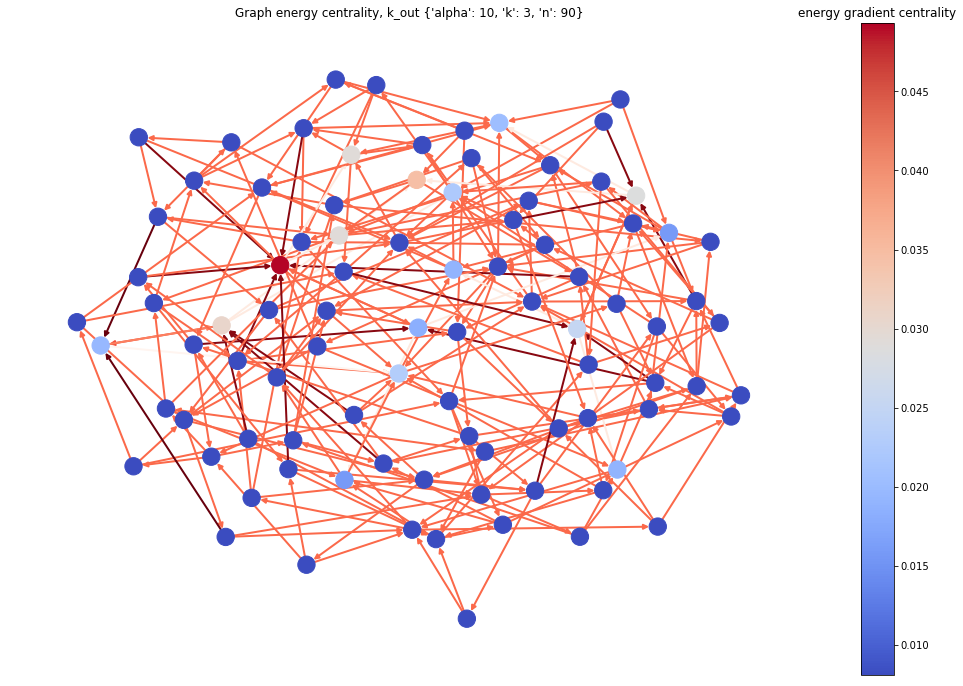

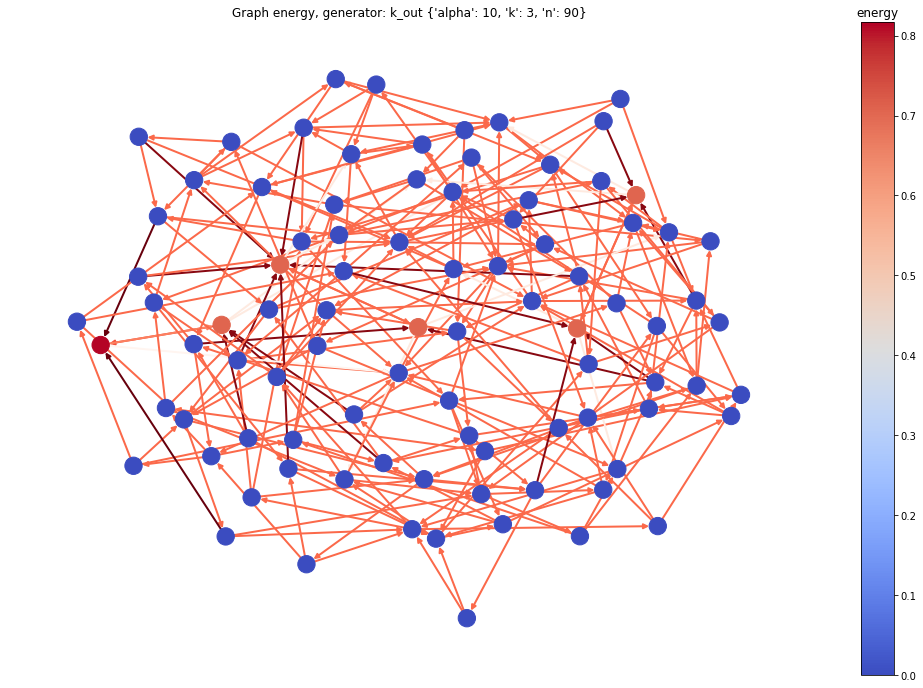

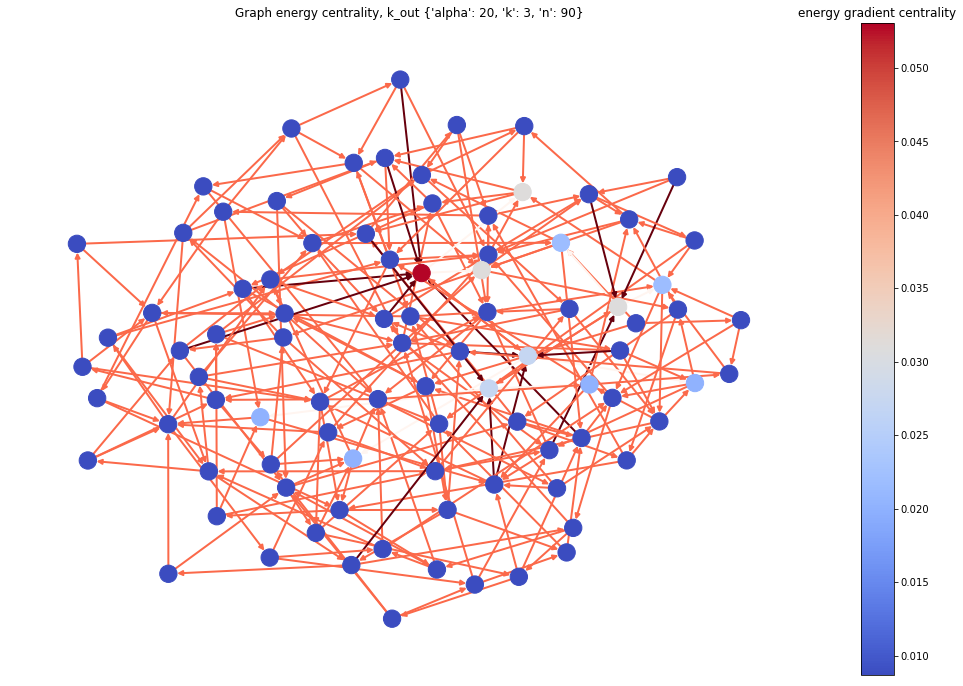

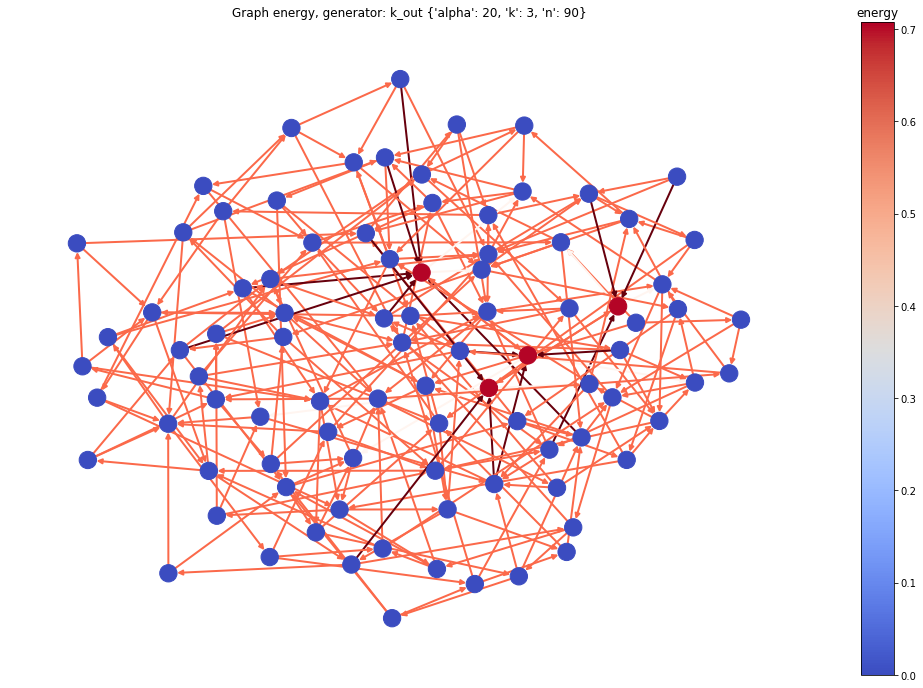

...

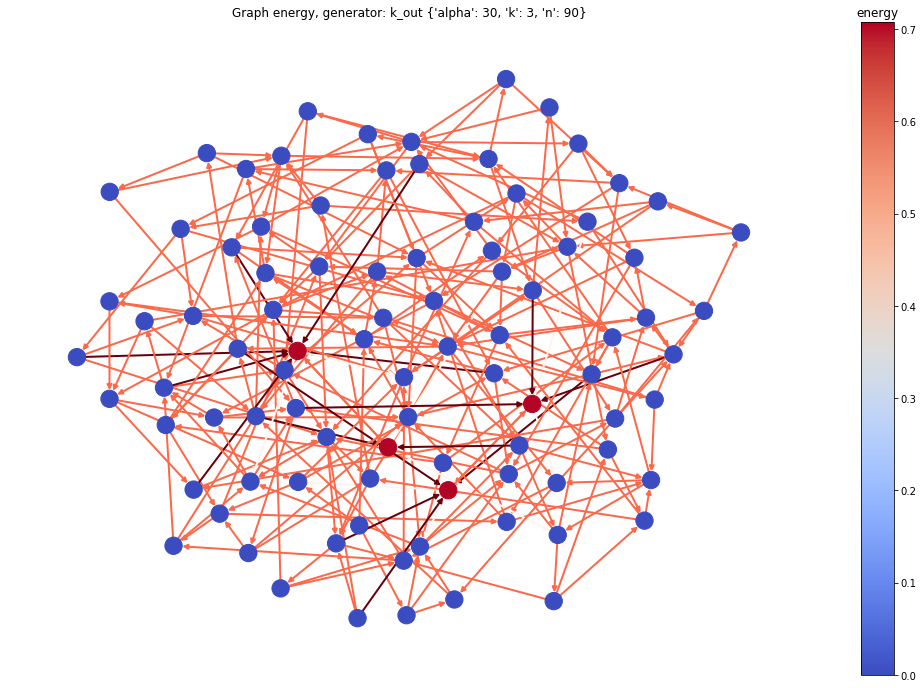

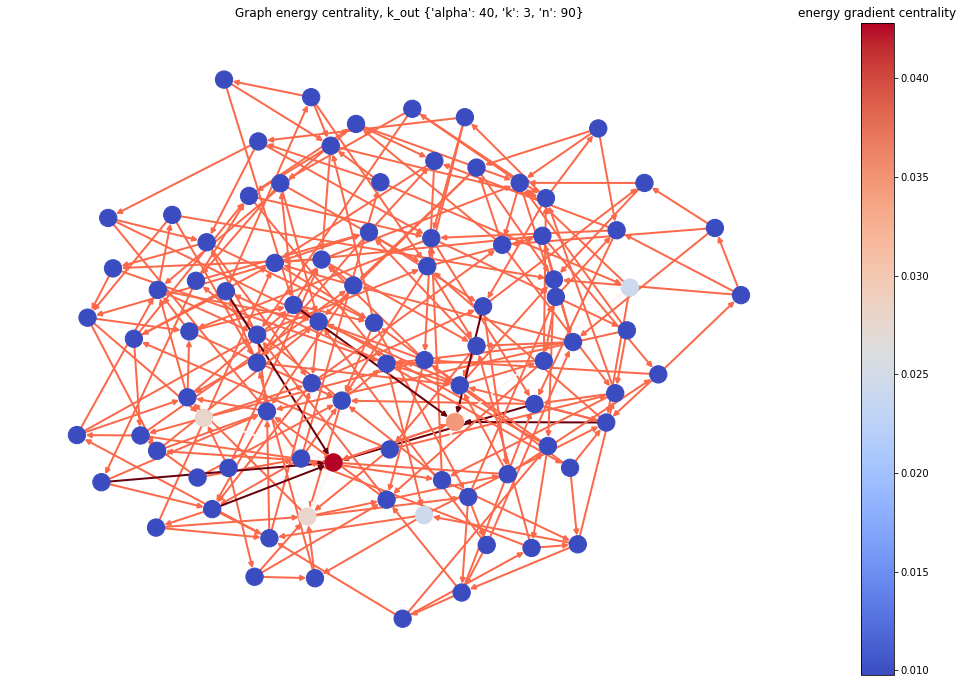

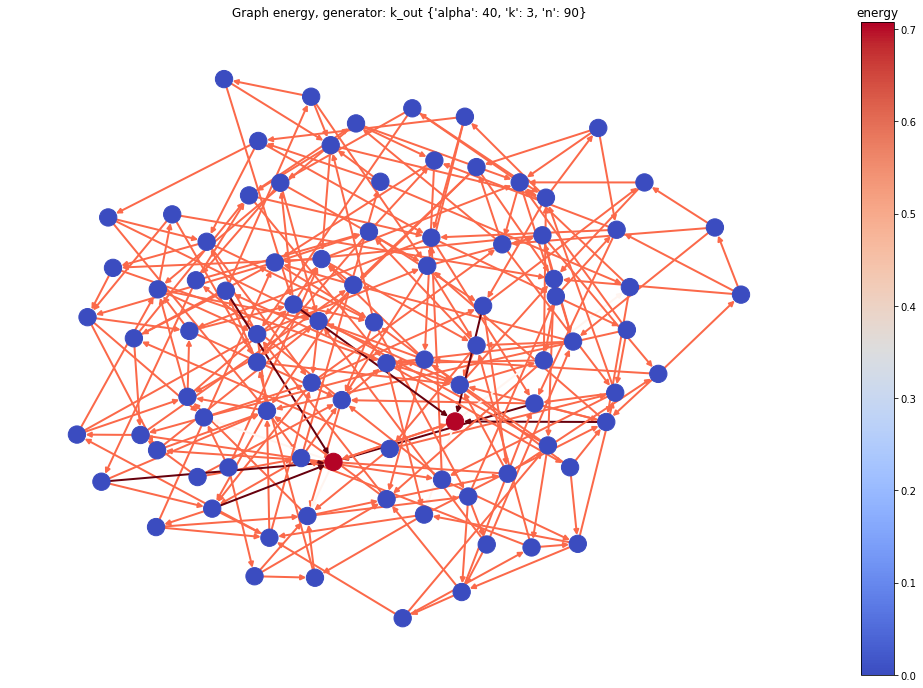

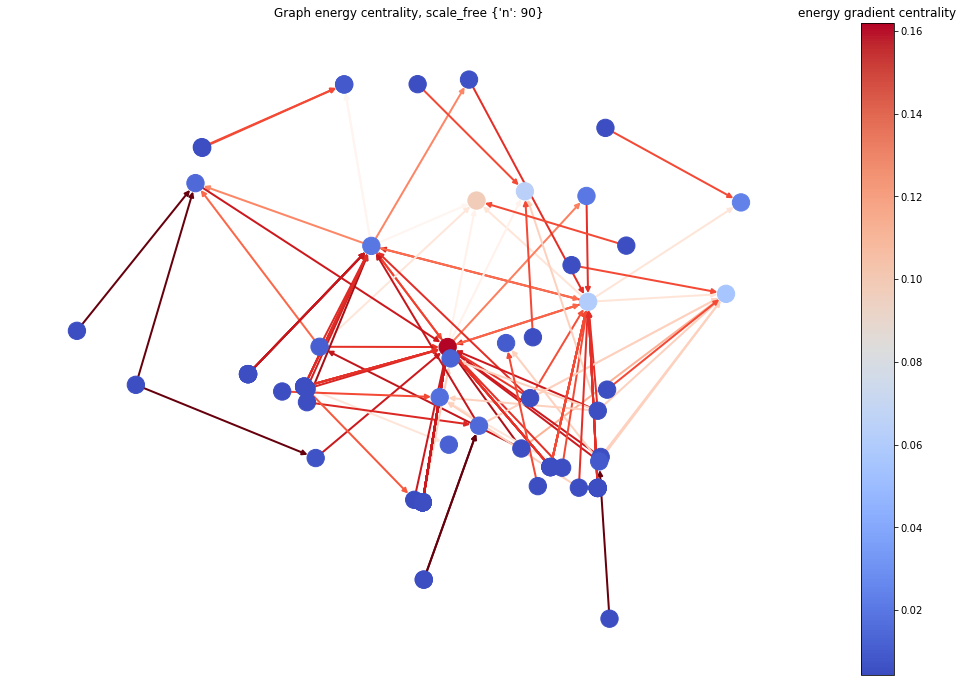

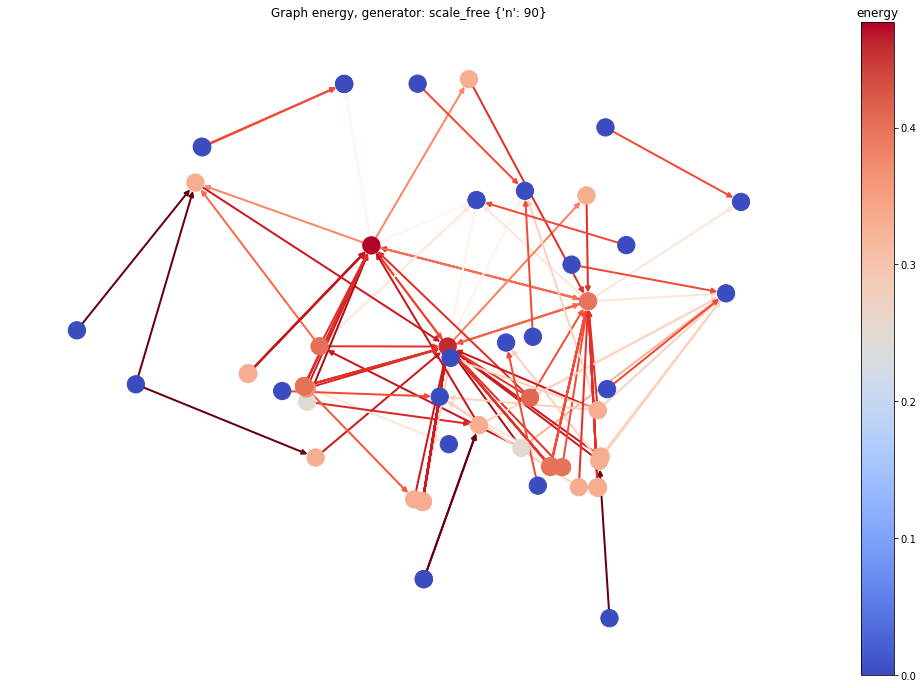

In [118]:
draw_synthetic_networks(graph_pagerank_df, GRAPH)

Graph Graph energy centrality, random {'n': 90, 'p': 0.2} does not contain randic_gradient_centrality or randic_gradient


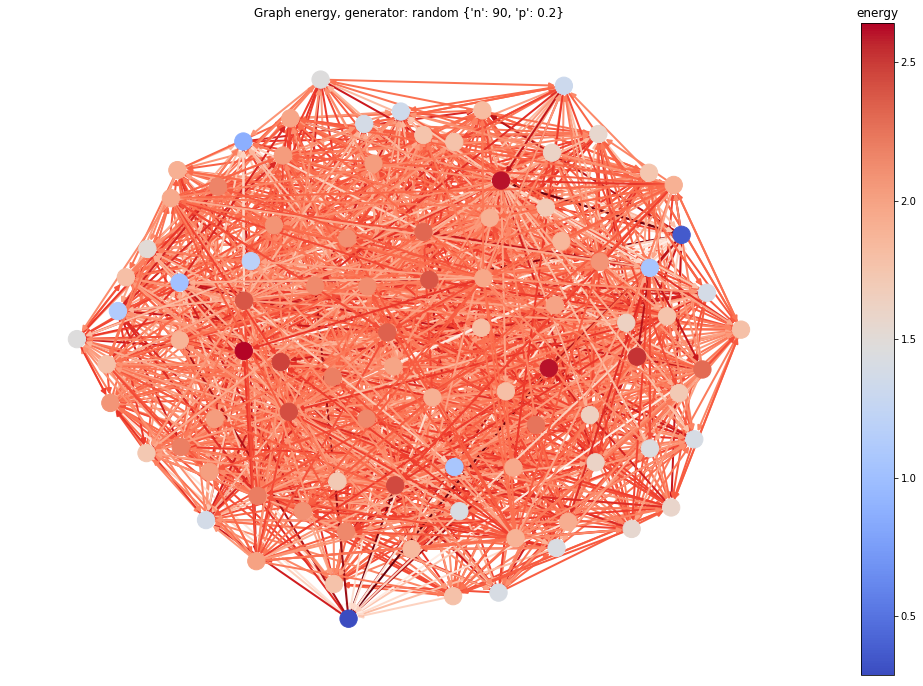

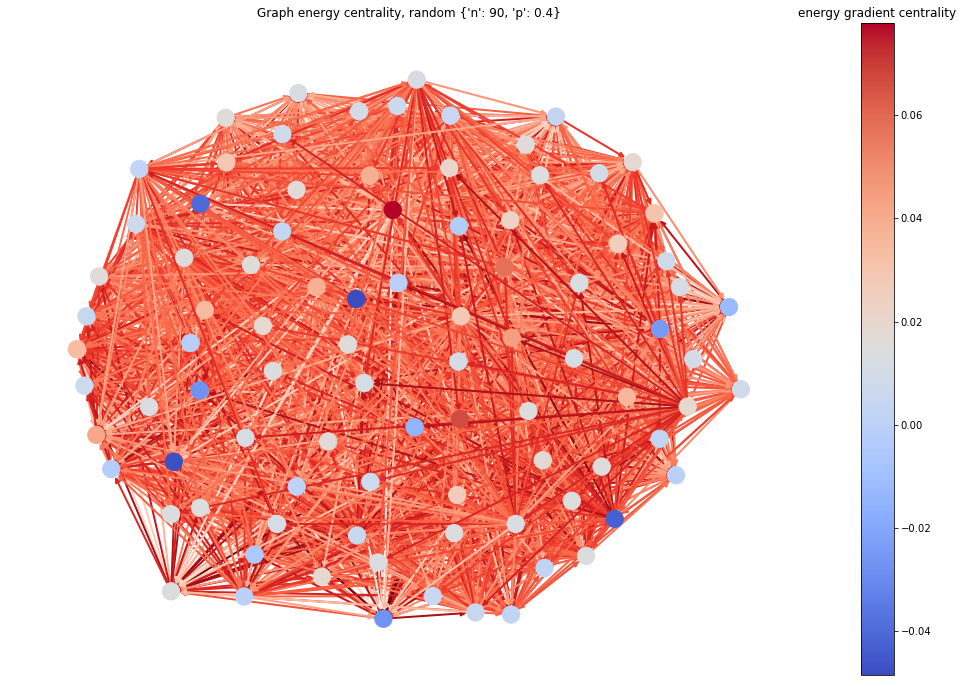

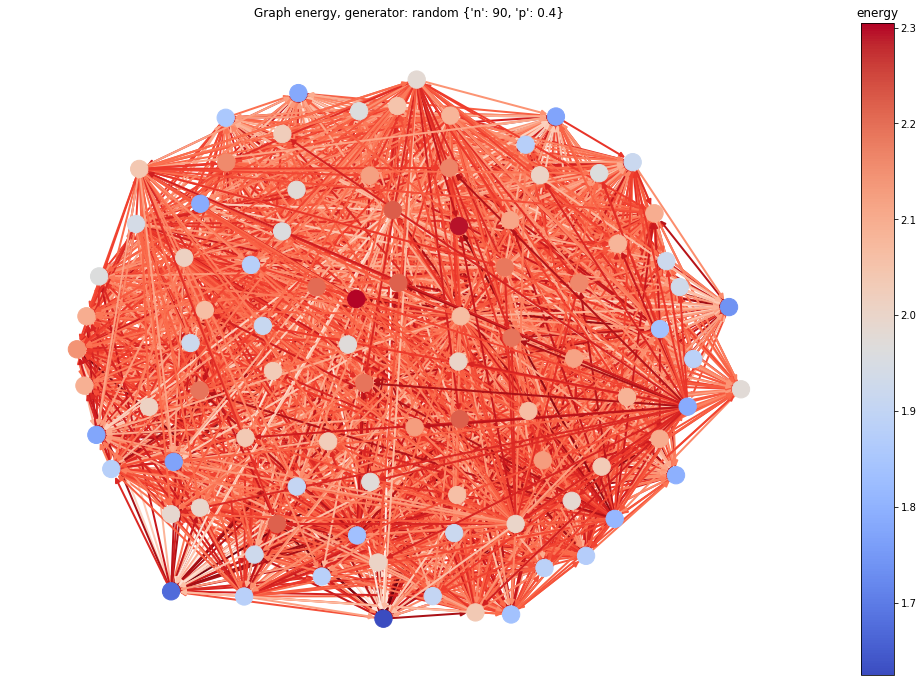

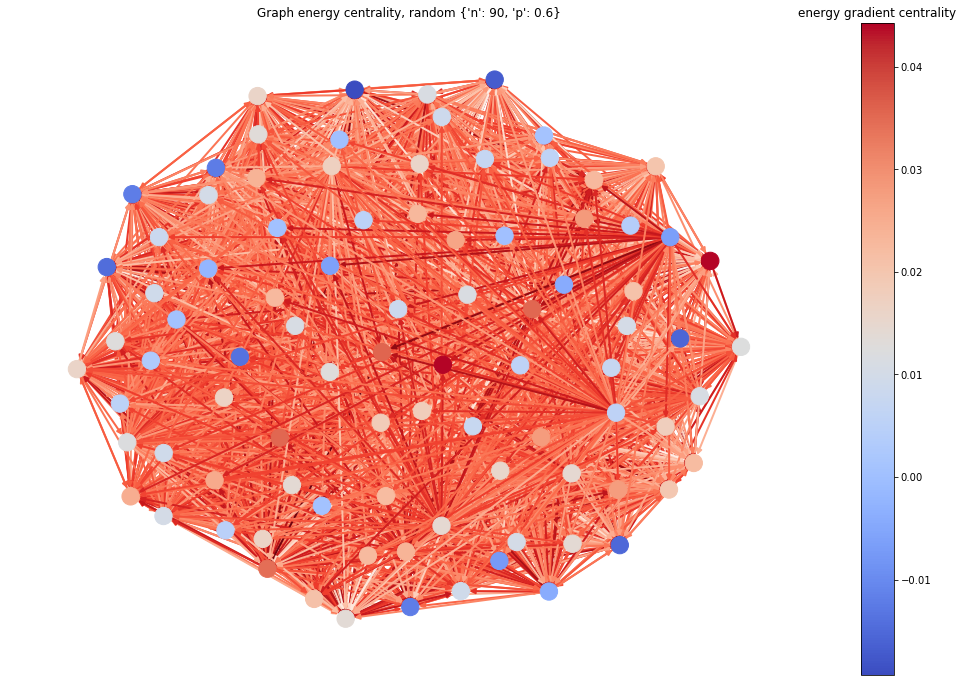

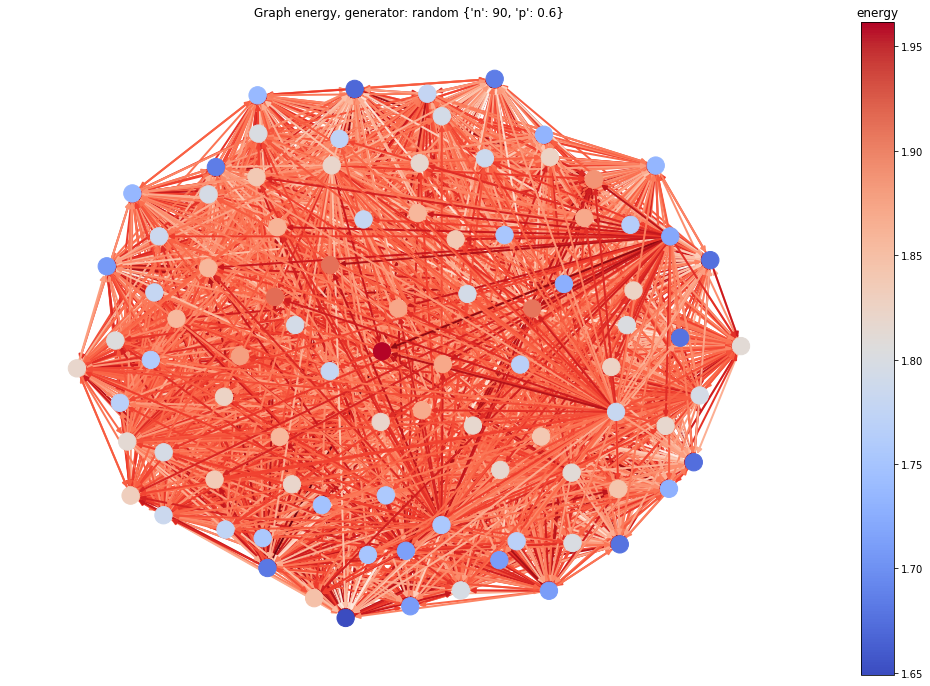

Graph Graph energy centrality, random {'n': 90, 'p': 0.8} does not contain randic_gradient_centrality or randic_gradient


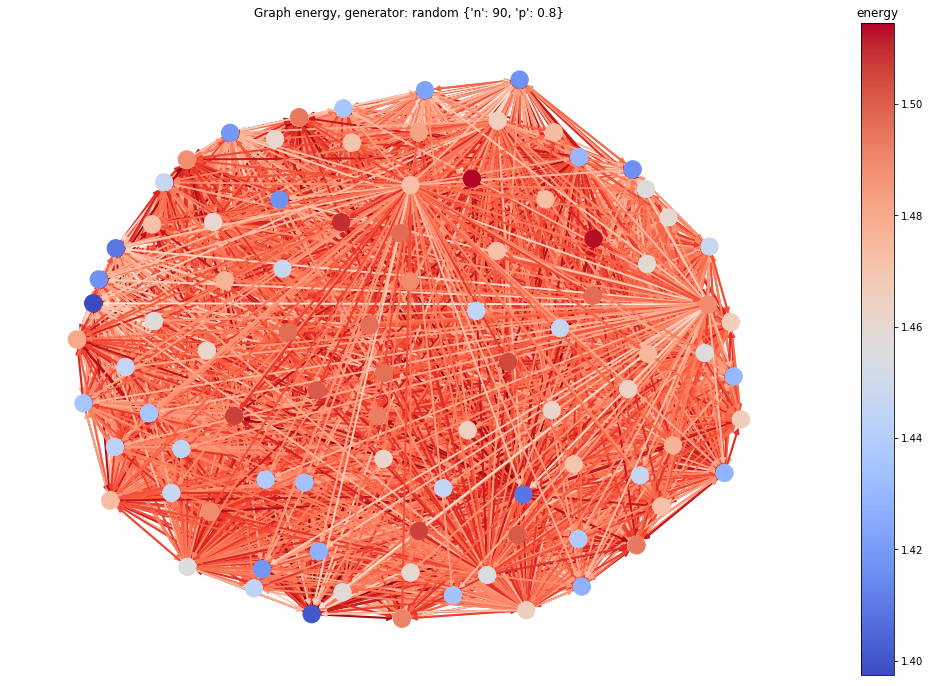

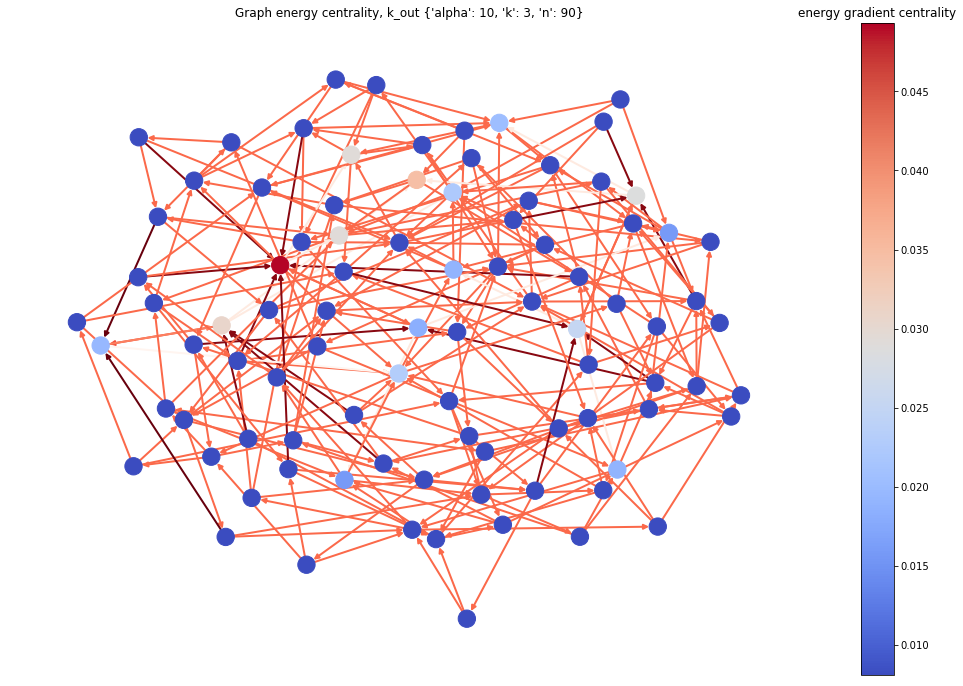

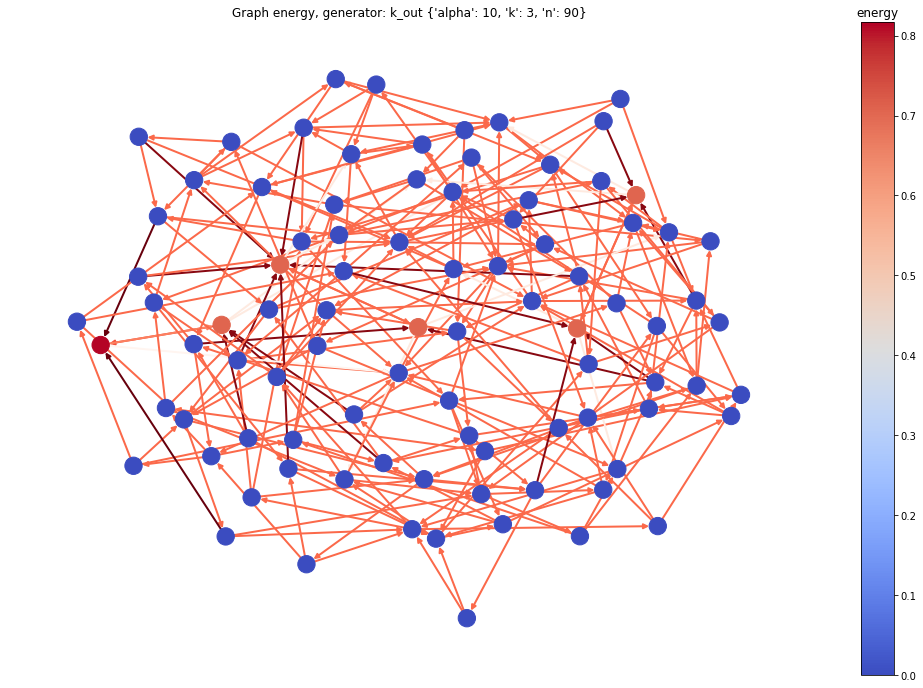

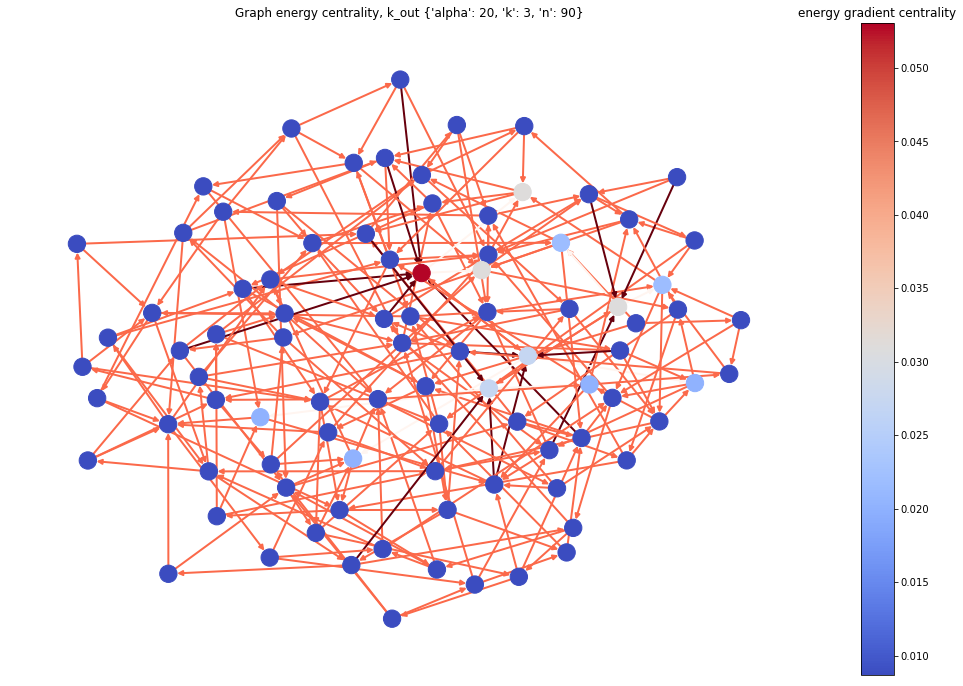

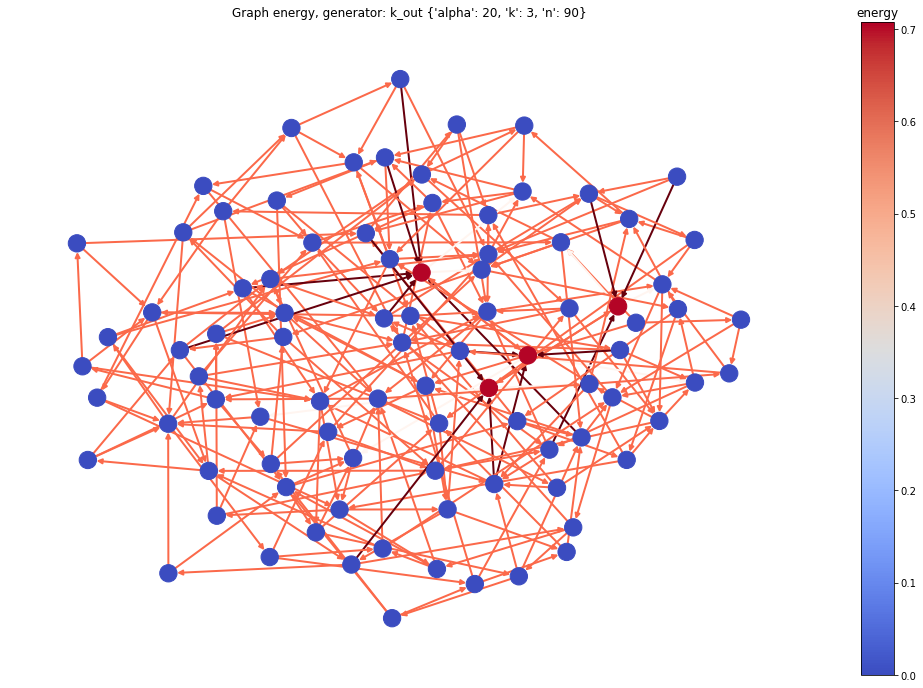

...

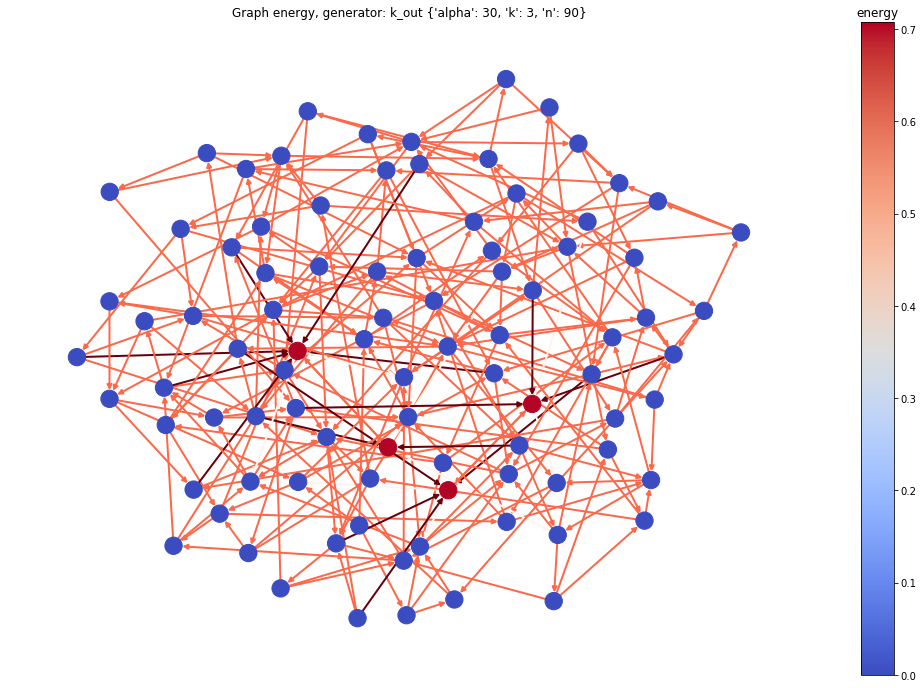

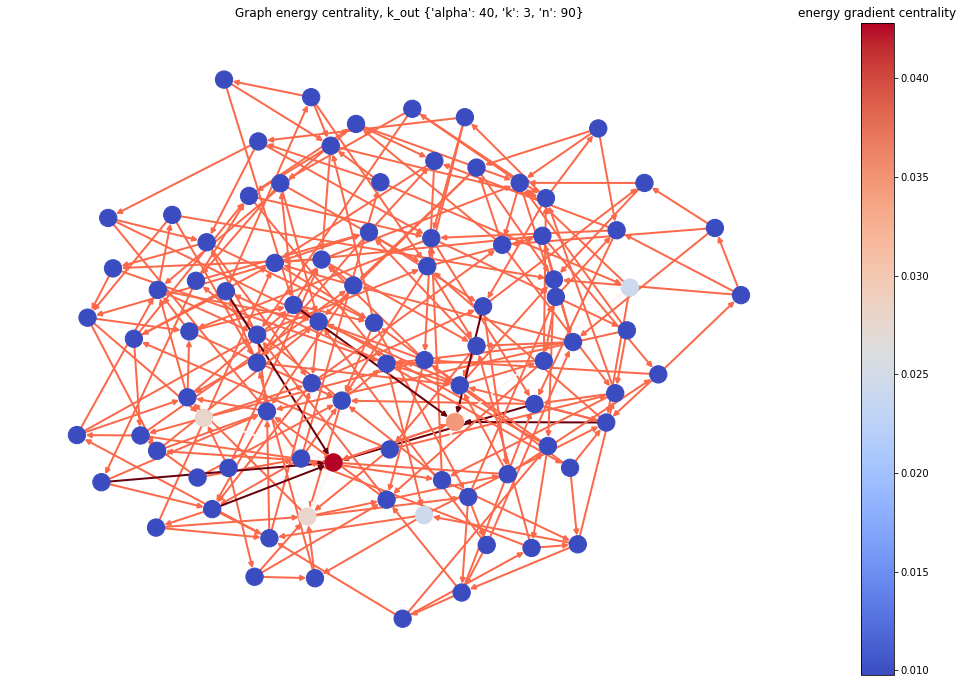

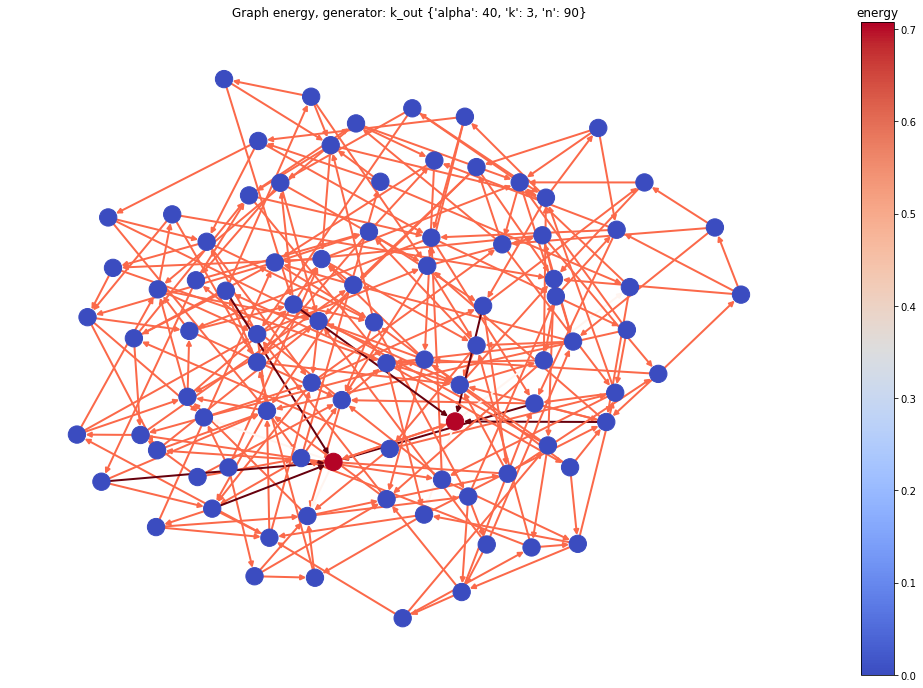

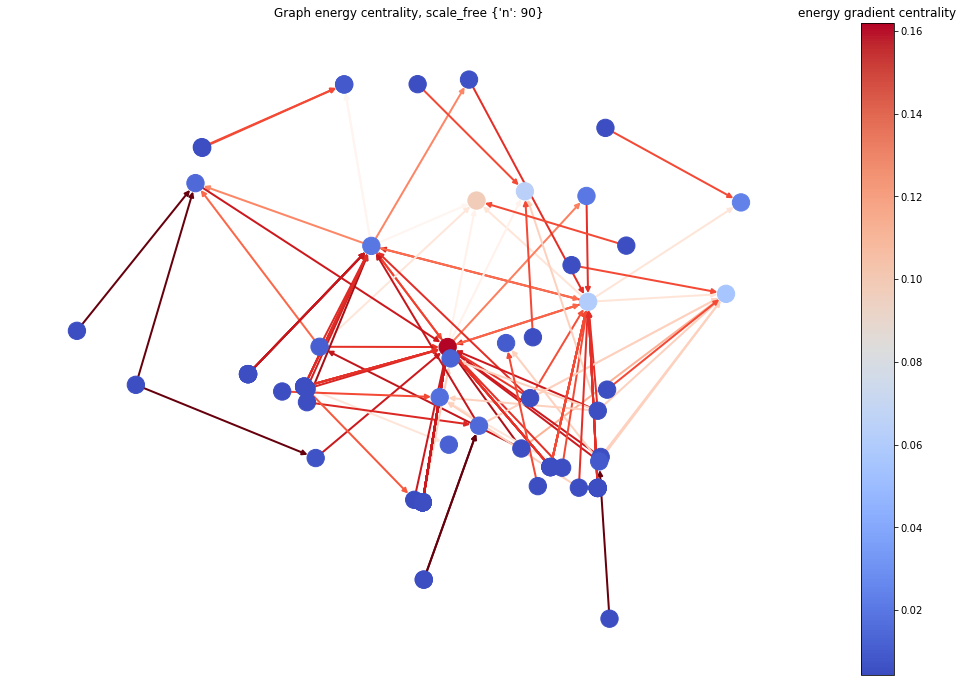

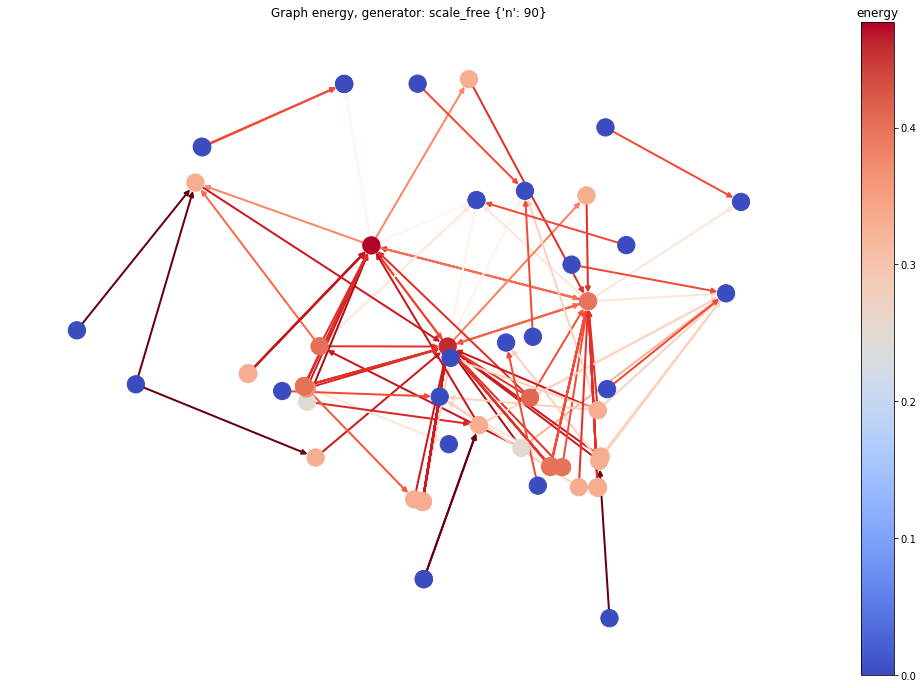

In [119]:
draw_synthetic_networks(graph_pagerank_df, RANDIC)

## Empirical networks

In [255]:
datasets = nu.create_datasets('konect.uni').filter(directed=True, min_size=50, max_size=1000, max_density=0.5)
networks_df = datasets.download_and_build_networks('data/')

### Calculating energy gradient centralities

In [256]:
empirical_graph_pagerank_df = calculate_pagerank(networks_df, methods, max_iter=2000, tol=1.0e-2)

C:\Users\Tomi\Anaconda3\envs\entropy\lib\site-packages\networkx\algorithms\link_analysis\pagerank_alg.py:155: RuntimeWarning: overflow encountered in double_scalars
  err = sum([abs(x[n] - xlast[n]) for n in x])
C:\Users\Tomi\Anaconda3\envs\entropy\lib\site-packages\networkx\algorithms\link_analysis\pagerank_alg.py:152: RuntimeWarning: overflow encountered in double_scalars
  x[nbr] += alpha * xlast[n] * W[n][nbr][weight]
C:\Users\Tomi\Anaconda3\envs\entropy\lib\site-packages\networkx\algorithms\link_analysis\pagerank_alg.py:152: RuntimeWarning: invalid value encountered in double_scalars
  x[nbr] += alpha * xlast[n] * W[n][nbr][weight]
C:\Users\Tomi\Anaconda3\envs\entropy\lib\site-packages\networkx\algorithms\link_analysis\pagerank_alg.py:147: RuntimeWarning: overflow encountered in double_scalars
  danglesum = alpha * sum(xlast[n] for n in dangling_nodes)
C:\Users\Tomi\Anaconda3\envs\entropy\lib\site-packages\networkx\algorithms\link_analysis\pagerank_alg.py:153: RuntimeWarning: inva

C:\Users\Tomi\Anaconda3\envs\entropy\lib\site-packages\networkx\algorithms\link_analysis\pagerank_alg.py:155: RuntimeWarning: invalid value encountered in double_scalars
  err = sum([abs(x[n] - xlast[n]) for n in x])


In [257]:
empirical_graph_pagerank_df

,name,category,directed,num_nodes,num_edges,tsv_url,graph,randic_pagerank,graph_pagerank
87,foodweb-baydry,Trophic,True,128,2137,http://konect.uni-koblenz.de/downloads/tsv/foo...,"(1, 2, 1.261404, 3, 21.9353, 4, 0.193461, 5, 1...","{'1': 0.0004232888888889032, '2': 0.0004400256...","{'1': 0.0004232888888889032, '2': 0.0004610024..."
88,foodweb-baywet,Trophic,True,128,2106,http://konect.uni-koblenz.de/downloads/tsv/foo...,"(1, 2, 5.217257, 3, 73.88673, 4, 0.085891, 5, ...","{'1': 0.00042908622866766983, '2': 0.000445945...","{'1': 0.00042908622866766983, '2': 0.000464520..."
102,moreno_highschool,HumanSocial,True,70,366,http://konect.uni-koblenz.de/downloads/tsv/mor...,"(1, 2, 3, 4, 5, 6, 7, 8, 9, 10, 11, 12, 13, 14...",None,"{'1': 0.14199896093050227, '2': 0.106942974394..."
125,maayan-foodweb,Trophic,True,183,2494,http://konect.uni-koblenz.de/downloads/tsv/maa...,"(1, 2, 3, 4, 5, 6, 7, 8, 9, 10, 11, 12, 13, 14...","{'1': 0.0008450535996894503, '2': 0.0009224892...","{'1': 0.0008450535996894503, '2': 0.0008915016..."
131,moreno_mac,Animal,True,62,1187,http://konect.uni-koblenz.de/downloads/tsv/mor...,"(1, 2, 3, 4, 6, 5, 7, 8, 9, 10, 11, 12, 13, 14...",None,None
149,moreno_innovation,HumanSocial,True,241,1098,http://konect.uni-koblenz.de/downloads/tsv/mor...,"(1, 2, 3, 4, 5, 6, 7, 8, 9, 10, 11, 12, 13, 14...","{'1': 0.000988274995265233, '2': 0.00986441969...",None
160,moreno_oz,HumanSocial,True,217,2672,http://konect.uni-koblenz.de/downloads/tsv/mor...,"(1, 2, 3, 4, 5, 6, 7, 8, 9, 10, 11, 12, 13, 14...","{'1': 0.05629236965270159, '2': -0.00854336752...","{'1': 0.023886593171863788, '2': 0.00829337290..."


In [263]:
flat_empirical_graph_pagerank_df = flatten_pagerank_df(empirical_graph_pagerank_df, pagerank_methods)

### Histograms

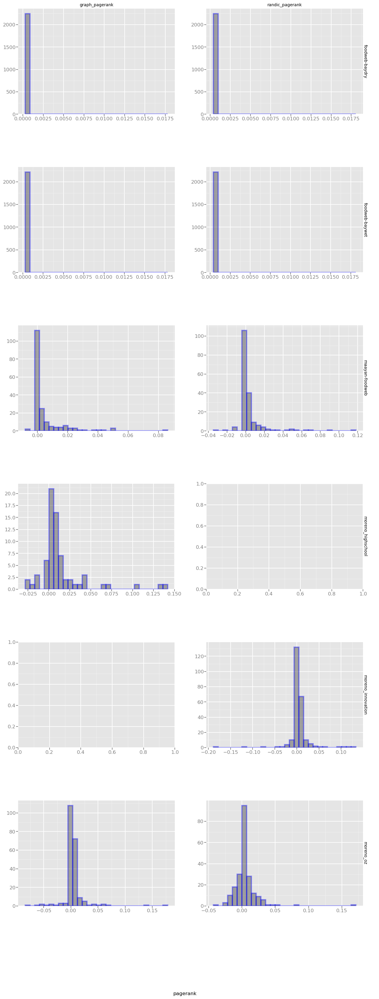

In [264]:
p = ggplot(aes(x='pagerank'), data=flat_empirical_graph_pagerank_df) + \
geom_histogram(alpha=0.4, color='blue', size=3, bins=BINS) + \
facet_grid('name', 'method', scales = "free")

p.make()
p.fig.set_size_inches(15, 40, forward=True)
p.fig.set_dpi(100)
p.fig

plt.show()

### Normality test

None of the graphs has normally distributed energy gradient centrality

In [267]:
test_normality(flat_empirical_graph_pagerank_df, ['name', 'method'])

pagerank
name              method                                                       
foodweb-baydry    graph_pagerank                      (6995.3400456493755, 0.0)
                  randic_pagerank                      (6985.899139186304, 0.0)
foodweb-baywet    graph_pagerank                       (6873.805033013574, 0.0)
                  randic_pagerank                      (6862.156130170233, 0.0)
maayan-foodweb    graph_pagerank    (168.1771552441039, 3.0254832135061176e-37)
                  randic_pagerank  (187.76000630234222, 1.6921258901611255e-41)
moreno_highschool graph_pagerank       (60.718725178615, 6.532754734555238e-14)
moreno_innovation randic_pagerank   (123.23590075500172, 1.736457525966275e-27)
moreno_oz         graph_pagerank     (198.3204603986576, 8.615077728579223e-44)
                  randic_pagerank   (245.46985425725978, 4.976206695448589e-54)

###  Visualisation of energy grdaient centrality in comparison to energy

In [92]:
get_graph_with_gradient_centrality = lambda s: get_graph_with_energy_data(s['graph'], methods, max_iter=2000, tol=1.0e-2)
empirical_graphs_with_data_series = empirical_graph_pagerank_df.progress_apply(get_graph_with_gradient_centrality, axis=1)
empirical_graph_pagerank_df = empirical_graph_pagerank_df.assign(graph=empirical_graphs_with_data_series)

C:\Users\Tomi\Anaconda3\envs\entropy\lib\site-packages\networkx\algorithms\link_analysis\pagerank_alg.py:155: RuntimeWarning: overflow encountered in double_scalars
  err = sum([abs(x[n] - xlast[n]) for n in x])
C:\Users\Tomi\Anaconda3\envs\entropy\lib\site-packages\networkx\algorithms\link_analysis\pagerank_alg.py:152: RuntimeWarning: overflow encountered in double_scalars
  x[nbr] += alpha * xlast[n] * W[n][nbr][weight]
C:\Users\Tomi\Anaconda3\envs\entropy\lib\site-packages\networkx\algorithms\link_analysis\pagerank_alg.py:152: RuntimeWarning: invalid value encountered in double_scalars
  x[nbr] += alpha * xlast[n] * W[n][nbr][weight]
C:\Users\Tomi\Anaconda3\envs\entropy\lib\site-packages\networkx\algorithms\link_analysis\pagerank_alg.py:147: RuntimeWarning: overflow encountered in double_scalars
  danglesum = alpha * sum(xlast[n] for n in dangling_nodes)
C:\Users\Tomi\Anaconda3\envs\entropy\lib\site-packages\networkx\algorithms\link_analysis\pagerank_alg.py:153: RuntimeWarning: inva

In [93]:
empirical_graph_pagerank_df

,name,category,directed,num_nodes,num_edges,tsv_url,graph,graph_pagerank,randic_pagerank
87,foodweb-baydry,Trophic,True,128,2137,http://konect.uni-koblenz.de/downloads/tsv/foo...,"(1, 2, 1.261404, 3, 21.9353, 4, 0.193461, 5, 1...","{'1': 0.0004232888888889032, '2': 0.0004610024...","{'1': 0.0004232888888889032, '2': 0.0004400256..."
88,foodweb-baywet,Trophic,True,128,2106,http://konect.uni-koblenz.de/downloads/tsv/foo...,"(1, 2, 5.217257, 3, 73.88673, 4, 0.085891, 5, ...","{'1': 0.00042908622866766983, '2': 0.000464520...","{'1': 0.00042908622866766983, '2': 0.000445945..."
102,moreno_highschool,HumanSocial,True,70,366,http://konect.uni-koblenz.de/downloads/tsv/mor...,"(1, 2, 3, 4, 5, 6, 7, 8, 9, 10, 11, 12, 13, 14...","{'1': 0.14199899573994001, '2': 0.106942972105...",None
125,maayan-foodweb,Trophic,True,183,2494,http://konect.uni-koblenz.de/downloads/tsv/maa...,"(1, 2, 3, 4, 5, 6, 7, 8, 9, 10, 11, 12, 13, 14...","{'1': 0.0008450535996894503, '2': 0.0008915016...","{'1': 0.0008450535996894503, '2': 0.0009224892..."
131,moreno_mac,Animal,True,62,1187,http://konect.uni-koblenz.de/downloads/tsv/mor...,"(1, 2, 3, 4, 6, 5, 7, 8, 9, 10, 11, 12, 13, 14...",None,None
149,moreno_innovation,HumanSocial,True,241,1098,http://konect.uni-koblenz.de/downloads/tsv/mor...,"(1, 2, 3, 4, 5, 6, 7, 8, 9, 10, 11, 12, 13, 14...",None,"{'1': 0.000988274995265233, '2': 0.00986441969..."
160,moreno_oz,HumanSocial,True,217,2672,http://konect.uni-koblenz.de/downloads/tsv/mor...,"(1, 2, 3, 4, 5, 6, 7, 8, 9, 10, 11, 12, 13, 14...","{'1': 0.023886424761535806, '2': 0.00829337394...","{'1': 0.05629236902421505, '2': -0.00854337025..."


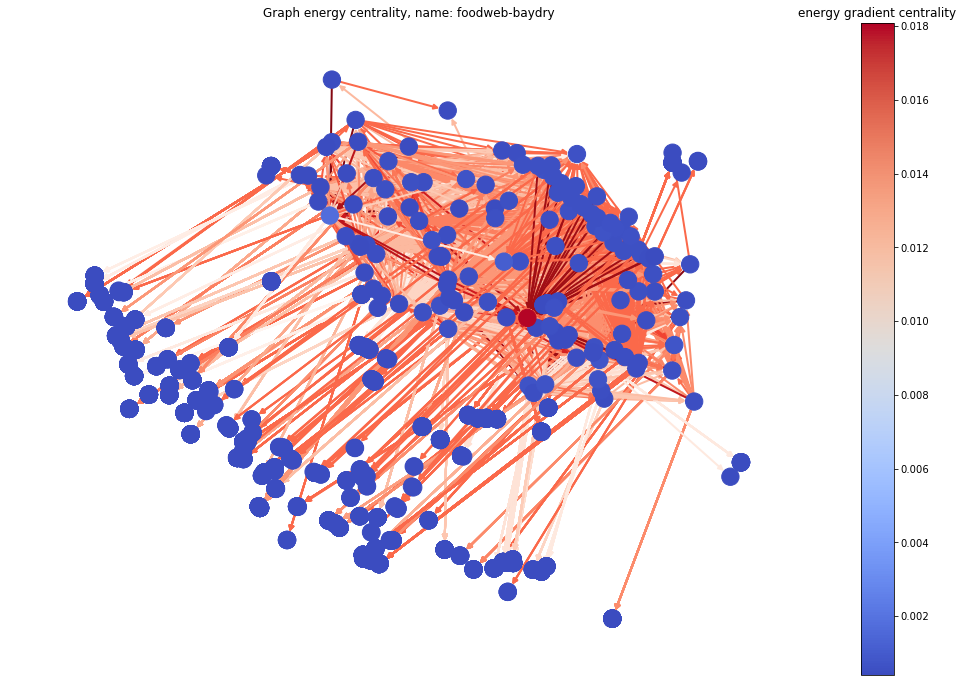

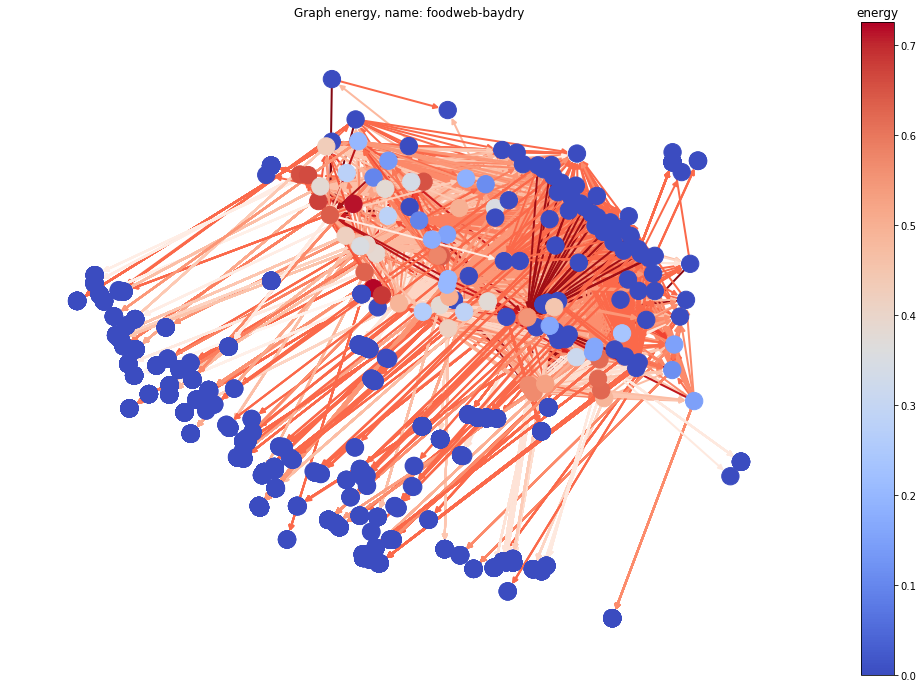

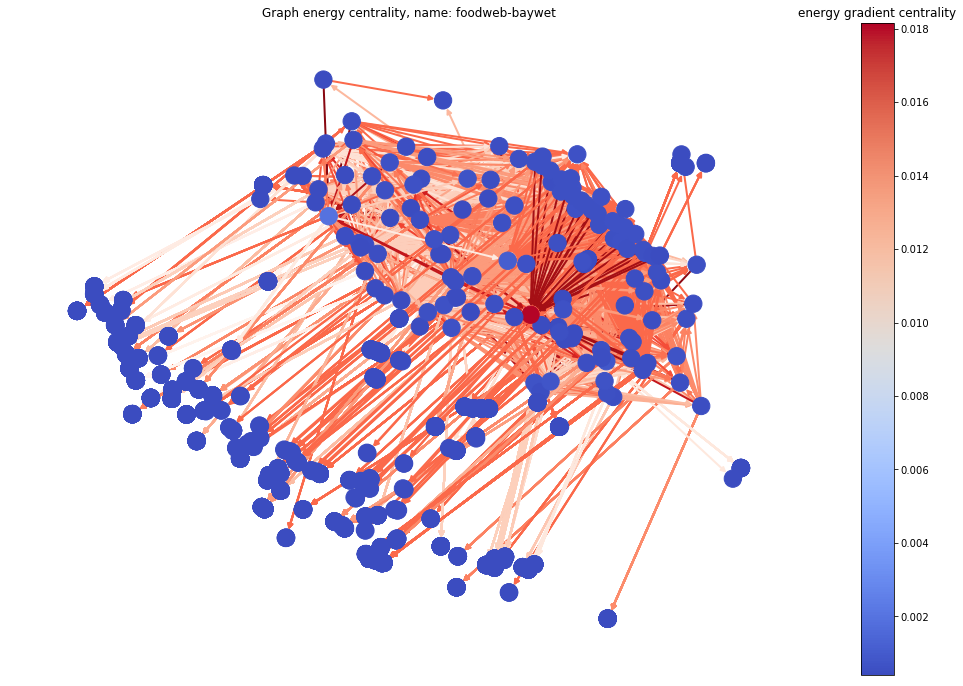

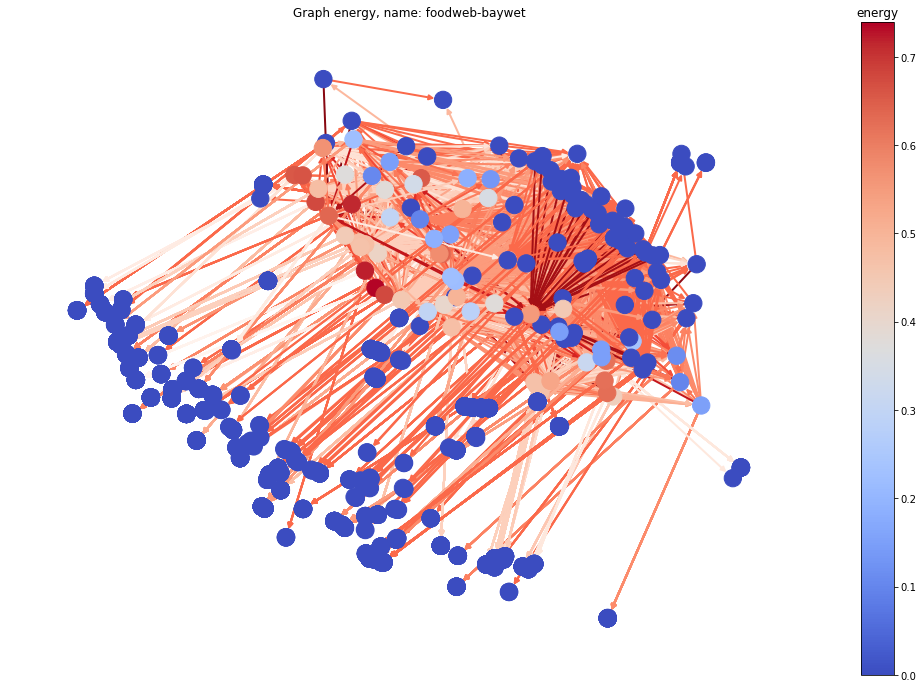

Graph Graph energy centrality, name: moreno_highschool does not contain graph_gradient_centrality or graph_gradient


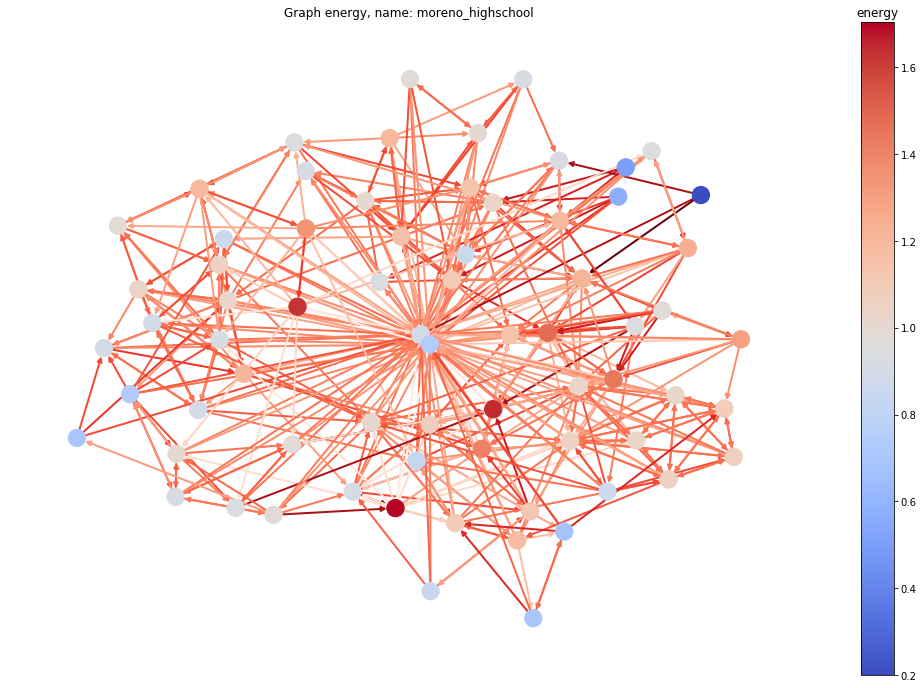

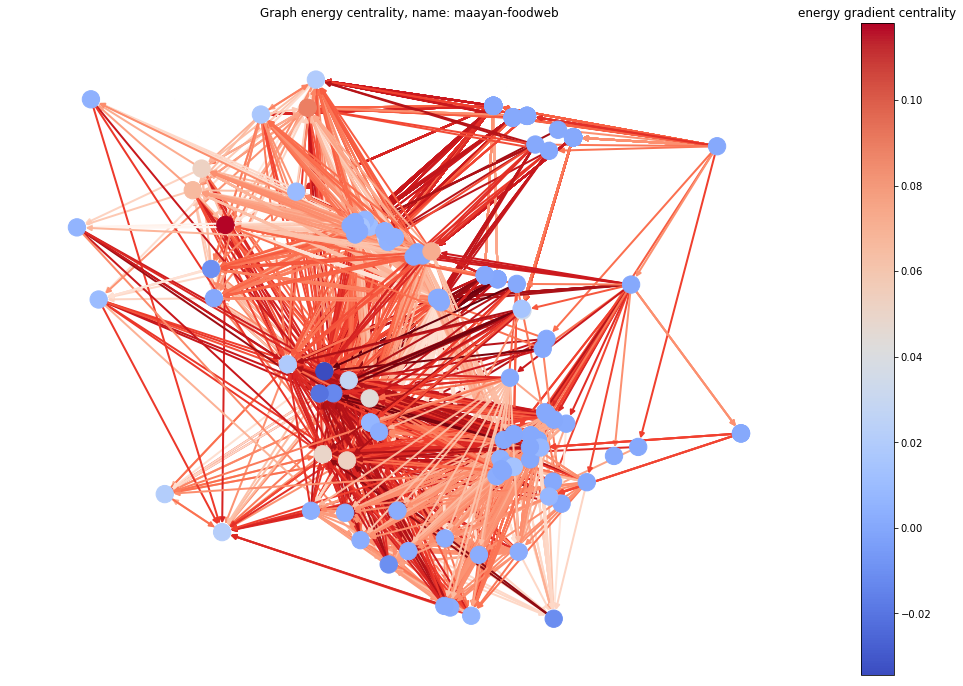

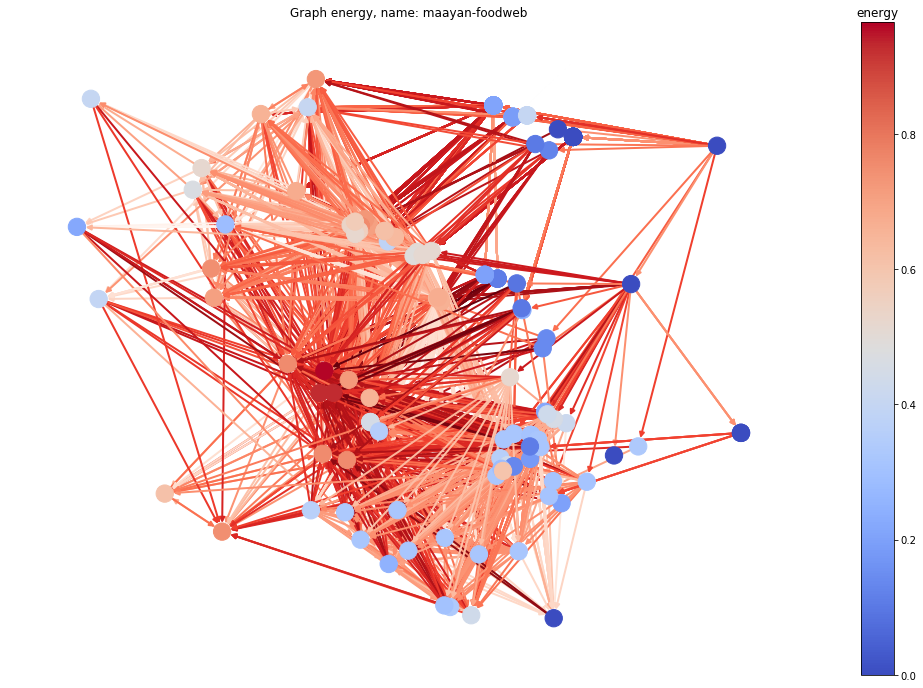

Graph Graph energy centrality, name: moreno_mac does not contain graph_gradient_centrality or graph_gradient


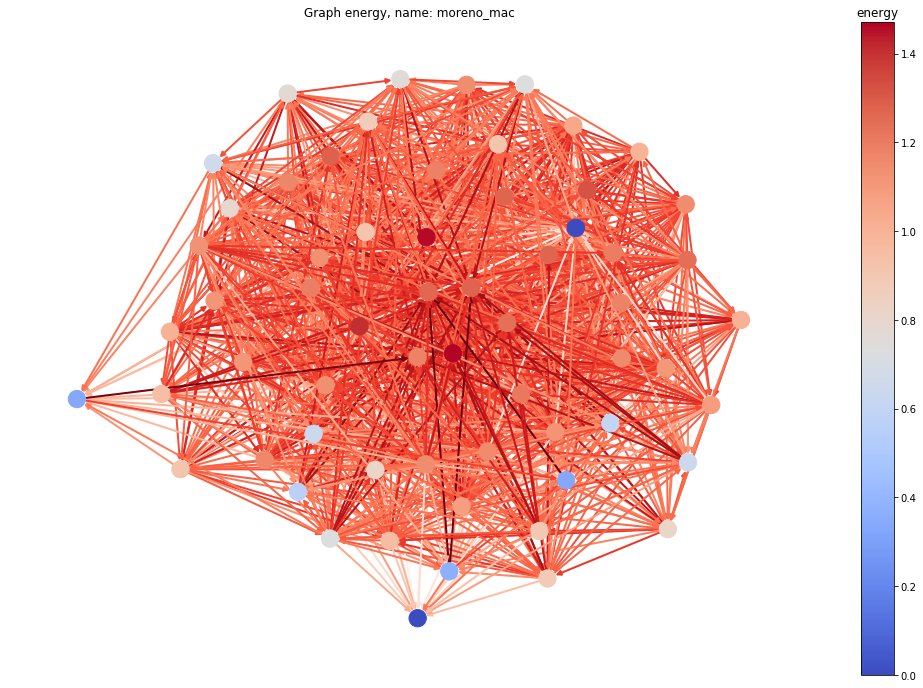

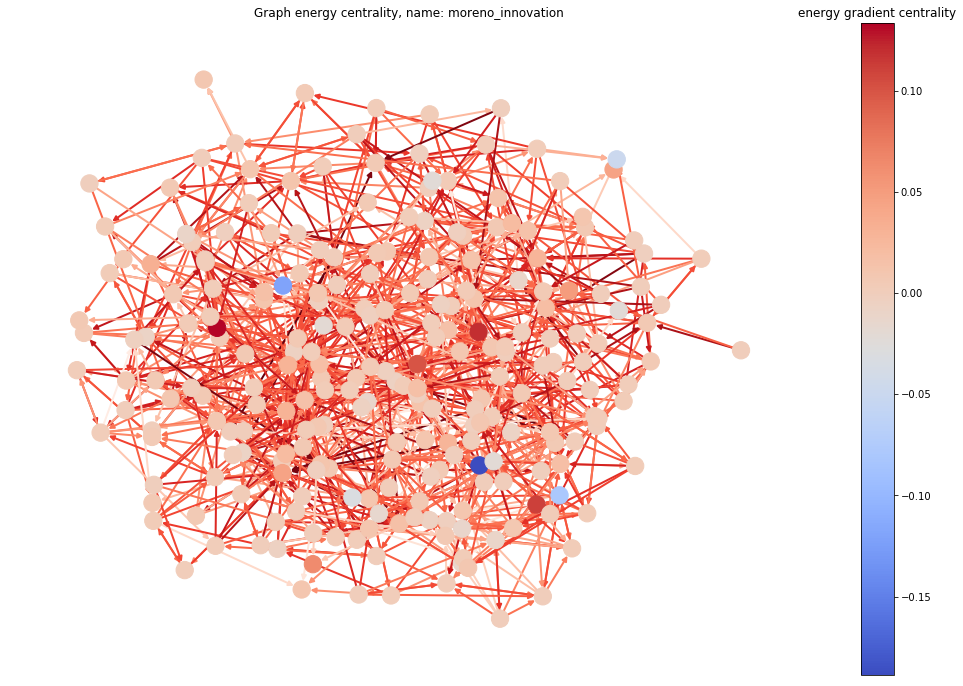

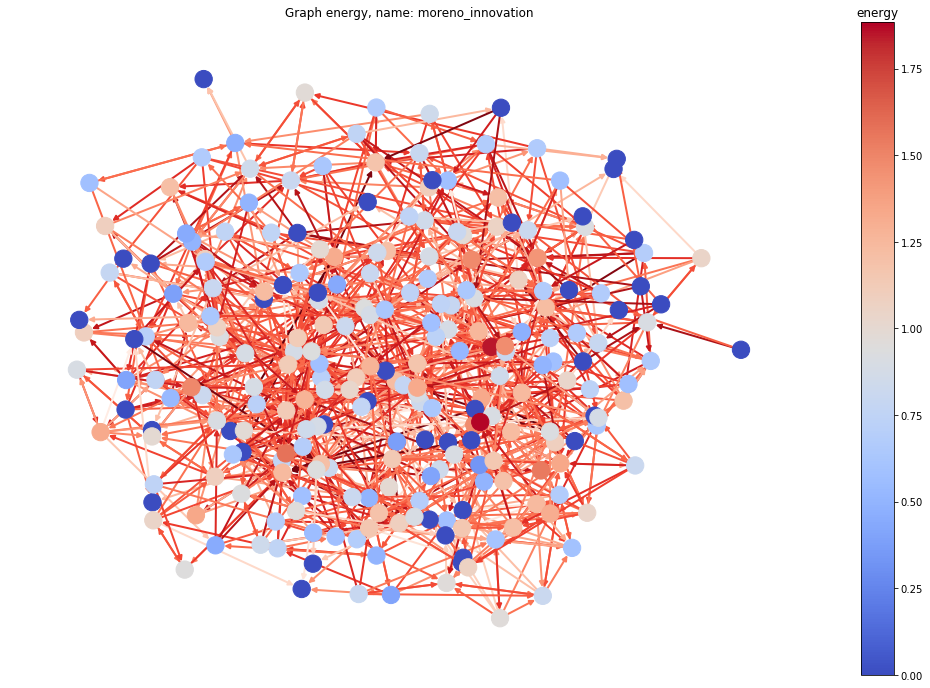

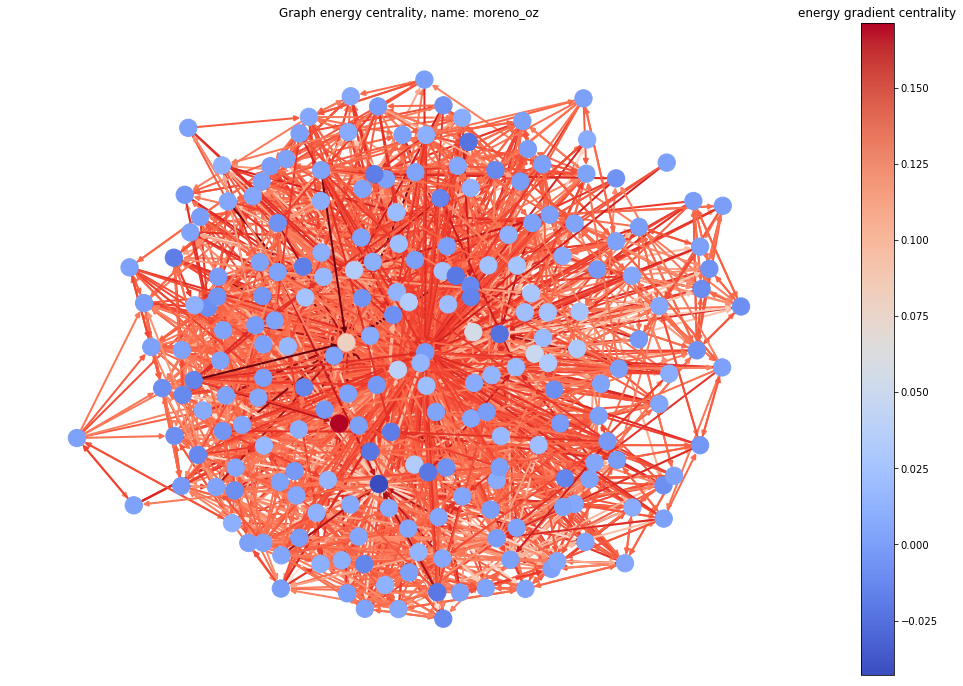

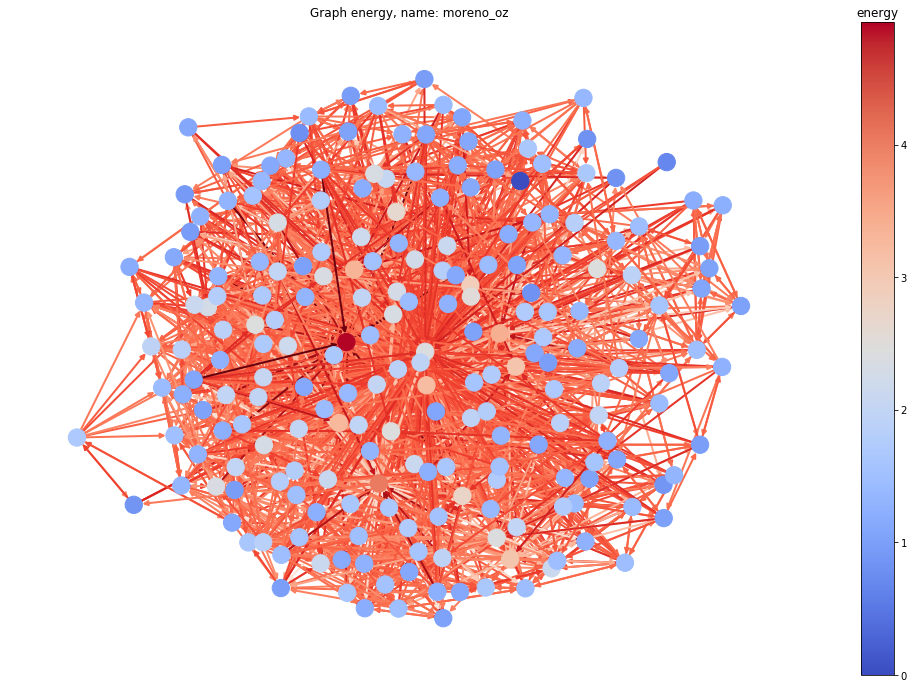

In [94]:
for _, (graph, name) in tqdm(list(empirical_graph_pagerank_df.loc[:,['graph', 'name']].iterrows())):
    if graph:
        title = f'Graph energy centrality, name: {name}'
        nodes_bar_title = 'energy gradient centrality'
        edges_bar_title = 'gradient'
        draw_network(graph, neg._get_centrality_name(GRAPH), neg._get_gradient_method_name(GRAPH), title, 
                     nodes_bar_title, edges_bar_title)
        title = f'Graph energy, name: {name}'
        nodes_bar_title = 'energy'
        draw_network(graph, neg._get_energy_method_name(GRAPH), neg._get_gradient_method_name(GRAPH), title,
                     nodes_bar_title, edges_bar_title)

## Correlation between energy gradient centralities and other nodes descriptors

In [32]:
def sums_helper(length,total_sum, max_sum):
    if length < 1:
        raise ValueError("Length must be positive")
    if length == 1:
        yield (total_sum/max_sum,)
    else:
        for value in range(1, total_sum):
            for permutation in sums_helper(length - 1,total_sum - value, max_sum):
                yield (value/max_sum,) + permutation
                
def sums(length,total_sum):
    return sums_helper(length, total_sum, total_sum)

In [133]:
ABG = list(sums(3, 14))
PARAM2_MAX = len(ABG) + 1
NUM_NODES = 100
PARAMS_N_P = ParameterGrid({'n': [NUM_NODES], 'p': [p/PARAM1_MAX for p in range(1, PARAM2_MAX)]})
PARAMS_N = ParameterGrid({'n': [NUM_NODES]})
PARAMS_N_K_ALPHA = ParameterGrid({'n': [NUM_NODES], 'k': [3], 'alpha': range(1, PARAM2_MAX)})
PARAMS_N_A_B_G = [{'n': NUM_NODES, 'a': a, 'b': b, 'g': g} for a, b, g in ABG]

GENERATORS2 = {
    'random':     Gen(lambda n, p: 
                      nx.erdos_renyi_graph(n=n, p=p, directed=True, seed=SEED),                 PARAMS_N_P),
    'k_out':      Gen(lambda n, k, alpha: nx.DiGraph(nx.random_k_out_graph(
                      n=n, k=k, alpha=alpha, self_loops=False, seed=SEED)),                     PARAMS_N_K_ALPHA),
    'scale_free': Gen(lambda n, a, b, g: 
                      nx.DiGraph(nx.scale_free_graph(n=n,alpha=a, beta=b, gamma=g, seed=SEED)), PARAMS_N_A_B_G)
                 
}

In [134]:
synthetic_graphs_df = create_graphs(GENERATORS2)

In [135]:
CENTRALITIES = {
    'eigencentrality': nx.pagerank,
    'betweenness': nx.betweenness_centrality,
    'closeness': nx.closeness_centrality,
    'degree': nx.degree_centrality,
    'graph_gradient': lambda g: neg.get_energy_gradient_centrality(g, method=GRAPH, max_iter=1000, tol=1.0e-3),
    'randic_gradient': lambda g: neg.get_energy_gradient_centrality(g, method=RANDIC, max_iter=1000, tol=1.0e-3),
}

def calculate_centralities(graph_df, centralities):
    for name, function in tqdm(list(centralities.items())):
        centrality_series = graph_df.progress_apply(lambda s: function(s['graph']), axis=1)
        graph_df = graph_df.assign(**{name: centrality_series})
    return graph_df

In [136]:
synthetic_graphs_centralities_df = calculate_centralities(synthetic_graphs_df, CENTRALITIES)

C:\Users\Tomi\Anaconda3\envs\entropy\lib\site-packages\networkx\algorithms\link_analysis\pagerank_alg.py:155: RuntimeWarning: overflow encountered in double_scalars
  err = sum([abs(x[n] - xlast[n]) for n in x])
C:\Users\Tomi\Anaconda3\envs\entropy\lib\site-packages\networkx\algorithms\link_analysis\pagerank_alg.py:152: RuntimeWarning: overflow encountered in double_scalars
  x[nbr] += alpha * xlast[n] * W[n][nbr][weight]
C:\Users\Tomi\Anaconda3\envs\entropy\lib\site-packages\networkx\algorithms\link_analysis\pagerank_alg.py:152: RuntimeWarning: invalid value encountered in double_scalars
  x[nbr] += alpha * xlast[n] * W[n][nbr][weight]
C:\Users\Tomi\Anaconda3\envs\entropy\lib\site-packages\networkx\algorithms\link_analysis\pagerank_alg.py:155: RuntimeWarning: invalid value encountered in double_scalars
  err = sum([abs(x[n] - xlast[n]) for n in x])
C:\Users\Tomi\Anaconda3\envs\entropy\lib\site-packages\networkx\algorithms\link_analysis\pagerank_alg.py:153: RuntimeWarning: invalid valu

C:\Users\Tomi\Anaconda3\envs\entropy\lib\site-packages\networkx\algorithms\link_analysis\pagerank_alg.py:147: RuntimeWarning: overflow encountered in double_scalars
  danglesum = alpha * sum(xlast[n] for n in dangling_nodes)


In [137]:
synthetic_graphs_centralities_df.isnull().sum()

a                  156
alpha              156
b                  156
g                  156
generator            0
graph                0
id                   0
k                  156
n                    0
p                  156
params_num           0
eigencentrality      0
betweenness          0
closeness            0
degree               0
graph_gradient      34
randic_gradient     29
dtype: int64

In [138]:
def flatten_centralities_df(centralities_df, centrality_names):
    other_attrs = list(set(centralities_df.columns).difference(centrality_names))
    centrs_length = len(centrality_names)
    rows = []
    for _, row in centralities_df.loc[:, centrality_names + other_attrs].iterrows():
        other_attrs_dict = {name: value for name, value in zip(other_attrs, row[centrs_length:])}
        centrs = {name: centr for name, centr in zip(centrality_names, row[:centrs_length]) if centr}
        for r in zip(*[r.items() for r in centrs.values()]):
            nodes, values = zip(*r)
            assert len(set(nodes)) == 1
            rows.append({**{name: value for name, value in zip(centrality_names, values)}, **other_attrs_dict})
    return pd.DataFrame(rows)

In [139]:
flat_synthetic_graphs_centralities_df2 = flatten_centralities_df(synthetic_graphs_centralities_df, list(CENTRALITIES.keys()))

In [225]:
synthethic_centralities_corrs_df = flat_synthetic_graphs_centralities_df2.loc[:, ['id', 'params_num', 'generator'] + list(CENTRALITIES.keys())] \
.groupby(['params_num', 'id', 'generator']).corr()

In [227]:
reset_synthethic_centralities_corrs_df = synthethic_centralities_corrs_df.reset_index()

In [228]:
reset_synthethic_centralities_corrs_df.head()

,params_num,id,generator,level_3,betweenness,closeness,degree,eigencentrality,graph_gradient,randic_gradient
0,0,"k_out {'alpha': 1, 'k': 3, 'n': 100}",k_out,betweenness,1.000000,0.798945,0.831460,0.892214,0.376890,0.377055
1,0,"k_out {'alpha': 1, 'k': 3, 'n': 100}",k_out,closeness,0.798945,1.000000,0.743253,0.790158,0.367085,0.366942
2,0,"k_out {'alpha': 1, 'k': 3, 'n': 100}",k_out,degree,0.831460,0.743253,1.000000,0.878814,0.516747,0.517322
3,0,"k_out {'alpha': 1, 'k': 3, 'n': 100}",k_out,eigencentrality,0.892214,0.790158,0.878814,1.000000,0.551610,0.551340
4,0,"k_out {'alpha': 1, 'k': 3, 'n': 100}",k_out,graph_gradient,0.376890,0.367085,0.516747,0.551610,1.000000,0.999953


In [230]:
id_vars = ['params_num','generator', 'level_3', 'id']
value_vars = list(set(reset_synthethic_centralities_corrs_df.columns).difference(id_vars))

melted_synthethic_centralities_corrs_df = reset_synthethic_centralities_corrs_df.melt(id_vars=id_vars,
                                             value_vars=value_vars)

In [233]:
plots = {}
for centrality in ['graph_gradient', 'randic_gradient']:
    df = melted_synthethic_centralities_corrs_df.query('level_3 == @centrality and variable != level_3')

    p = ggplot(aes(x='params_num', y='value', color='variable'), data=df) + \
            geom_line() + facet_grid('variable', 'generator') + \
            ggtitle(f'Correlation of {centrality} with other node descriptors')
    plots[centrality] = p

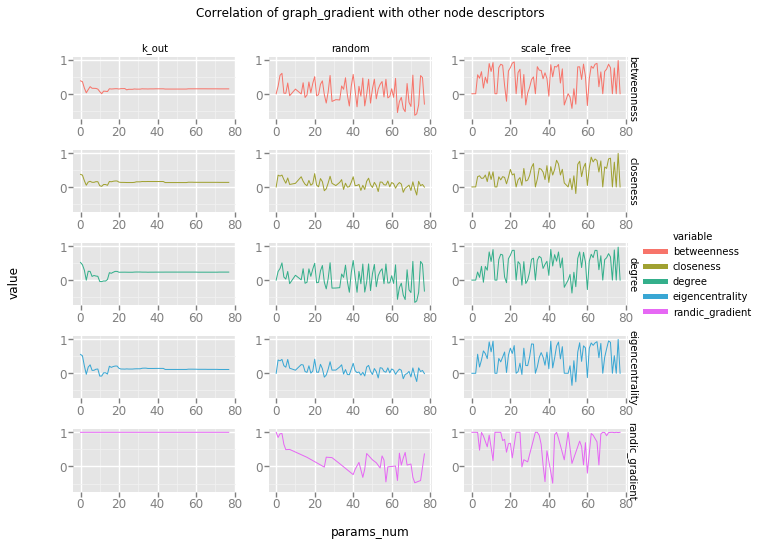

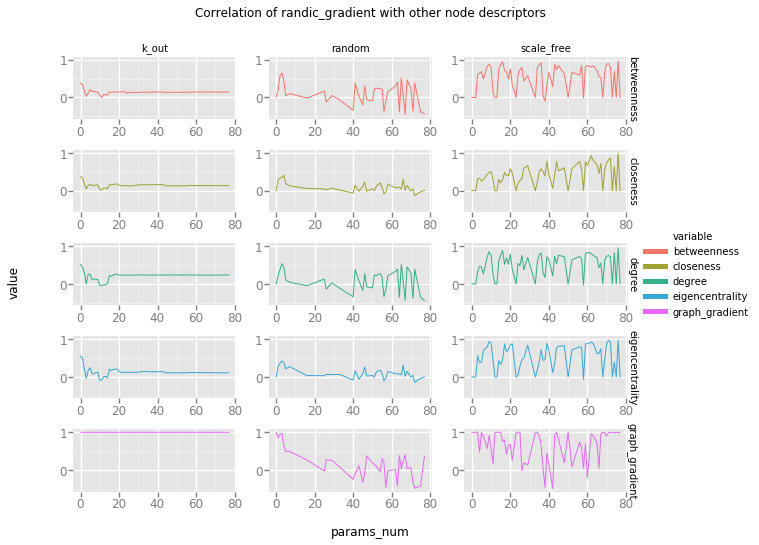

dict_values([<ggplot: (-9223371901794903990)>, <ggplot: (-9223371901794847765)>])

In [234]:
plots.values()

In [236]:
qgrid.show_grid(melted_synthethic_centralities_corrs_df)

QgridWidget(grid_options={'fullWidthRows': True, 'syncColumnCellResize': True, 'forceFitColumns': True, 'defau…